In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import seaborn as sns
import plotly.express as px
import folium
import geopandas as gpd
from shapely.geometry import Point
from scipy import stats
from itertools import count
from matplotlib.colors import LinearSegmentedColormap, PowerNorm

import warnings
warnings.filterwarnings("ignore")

# Latar Belakang
Bangkok merupakan salah satu pasar Airbnb paling kompleks dan dinamis secara bisnis di Asia Tenggara. Didukung oleh jumlah arus wisatawan internasional yang pesat ini diperkirakan Bangkok secara konsisten menempati peringkat kota paling banyak dikunjungi di dunia, dengan Thailand menerima 39,8 juta wisatawan internasional pada 2019 (puncak pra-pandemi menurut Tourism Authority of Thailand). Kota Bangkok ini menawarkan menawarkan berbagai tempat hunian yang bisa disewakan di berbagai wilayahnya dengan fasilitas yang memadai. Pasar ini juga melihat peningkatan signifikan pada segmen extended stay, didorong oleh kebijakan visa long-term untuk digital nomad dan pensiunan, yang mengubah dinamika permintaan dari akomodasi harian ke bulanan.

wilayah-wilayahnya seperti Ratchathewi dan Bang Na masing-masing menarik segmen tamu ataupun wisatawan yang berbeda, dengan preferensi fasilitas (amenities), rentang harga, dan ekspektasi pengalaman yang sangat spesifik. Listing berkinerja tinggi biasanya bukan sekadar properti dengan harga murah, tetapi yang mampu menyelaraskan lokasi strategis, fasilitas wisata lokal (dekat street food legendaris, transportasi publik), dan guest experience yang dipersonalisasi. Analisis ini menjadi krusial karena tingkat persaingan sangat tinggi terutama dari beberapa host tempat sewa baru dengan host tempat sewa lama. Tanpa pemahaman mendalam tentang faktor-faktor dalam penopang industri sewa hunian ini, dengan kebergantungan komisi yang diterima dari setiap penyewaan kamar setiap host yang telah berafiliasi dengan Airbnb tentunya menerima pendapatan melalui kerjasama tersebut.


## Pernyataan Masalah
Airbnb dengan segudang listings yang tersebar dalam beberapa wilayah Bangkok yang cukup luas ini, tentu sangat perlu adanya monitoring secara berkala dikala dan identifikasi perkembangan listings dalam beberapa kurun waktu. Maka saya paparkan apa saja masalah dan hal yang harus dibenahi:

Poin-Poin Penyelesaian Masalah:

* Penyeimbangan Distribusi Properti: Mengidentifikasi area yang memiliki permintaan tinggi tetapi tidak cukup banyak listingnya melalui analisis pasar, sehingga membantu mengarahkan ekspansi secara strategis dan memanfaatkan peluang yang belum dimanfaatkan.

* Pemberdayaan Host dalam Penetapan Harga: Memberikan informasi tentang harga yang kompetitif berdasarkan lokasi dan jenis kamar, sehingga memberi kemudahan bagi host untuk menentukan harga yang pas tanpa harus mencoba-coba.

* Amplifikasi Kredibilitas Listing: Melakukan strategi aktif untuk mendorong tamu memberikan ulasan, sehingga memperkuat kepercayaan calon pelanggan dan mengurangi rasa ragu calon pelanggan dalam melakukan pemesanan.

### Stakeholder

1. Property Operations Manager (Manager of Property Listings Airbnb)

Peran:
Bertanggung jawab untuk mengelola dan memantau performa semua listing di wilayah tertentu (misalnya Bangkok), termasuk memastikan kualitas listing, tingkat okupansi, dan ketersediaan sesuai standar Airbnb.

Kepentingan:

- Memastikan performansi listing tetap tinggi dan meminimalkan Low Performer.
- Meningkatkan kualitas pengalaman tamu melalui standarisasi properti.
- Menggunakan insight performa (dari kategori Top / Good / Low) untuk mengidentifikasi listing yang perlu pendampingan.

2. Brand Marketing Manager (Marketing Brand of Airbnb)

Peran:
Mengembangkan strategi pemasaran yang memperkuat citra Airbnb sebagai platform penginapan terpercaya dan populer di Bangkok.

Kepentingan:
- Meningkatkan brand awareness dan kepercayaan pengguna dengan menonjolkan Top Performer sebagai contoh keberhasilan.
- Mendorong engagement pengguna baru (baik host maupun guest) melalui kampanye digital.
- Memanfaatkan insight dari data (seperti hubungan harga dan review) untuk menentukan strategi promosi berbasis performa.

3. Business Development Lead (Airbnb Bangkok)

Peran:
Mengembangkan peluang bisnis baru, menjalin kerja sama strategis dengan mitra lokal, dan memperluas basis host maupun guest di wilayah Bangkok.

Kepentingan:
- Mengidentifikasi area dengan potensi pertumbuhan listing tinggi.
- Meningkatkan jumlah host aktif dengan memberikan pelatihan dan dukungan bisnis.
- Menggunakan data performa untuk memprediksi tren pasar dan mengarahkan investasi strategis Airbnb.

4. Host Partner (Pemilik atau Pengelola Properti)

Peran:
Pihak individu atau bisnis kecil yang menyewakan properti mereka melalui Airbnb. Mereka berinteraksi langsung dengan tamu dan menjadi wajah utama pengalaman Airbnb.

Kepentingan:
- Meningkatkan performa listing agar naik ke kategori Good atau Top Performer.
- Menetapkan harga kompetitif sambil menjaga tingkat okupansi tinggi.
- Mendapatkan review positif untuk memperkuat reputasi properti dan menarik lebih banyak tamu.

# Data
Dalam memulai pemahaman akan data hunian yang disajikan dalam dataset ini dan pertama-tama di bagian ini saya jabarkan sebagian besar isi beserta jumlah data yang akan saya analisis.

Dataset ini berisi informasi terkait hunian dari setiap pemberi sewa hunian khususnya di negara Thailand  yang terafiliasi dengan jasa penyewaan hunian Airbnb. Ada 14 kolom runtut dari id sampai number_of_reviews_ltm di dalam dataset Airbnb Listings Bangkok, yaitu:  

* id : ID unik untuk tiap hunian yang terdaftar di Airbnb
* name: nama properti hunian untuk di sewakan
* host_id : id unik untuk setiap pemberi sewa oleh pemilik tempat hunian
* host_name: nama pemilik tempat hunian yang memberikan sewa hunian
* neighbourhood: wilayah atau kawasan dari tempat sewa hunian berada
* latitude: garis lintang letak tempat sewa hunian
* longitude: garis bujur letak tempat sewa hunian
* room_type : tipe tempat sewa hunian ada: entire home, Private room, shared room, dan hotel room
* price: harga tempat sewa hunian per hari atau per malamnya
* minimum_nights : jumlah minimum sewa penginapan per malamnya
* number_of_reviews : jumlah review per tempat sewa huniannya
* last_review: tanggal terakhir dari review per tempat sewa huniannya
* reviews_per_month	: jumlah review terhitung dari satu bulan untuk per tempat sewa huniannya
* calculated_host_listings_count: jumlah hunian yang dikelola tuan rumah untuk disewakan yang diperbarui dalam wilayah/kawasan tertentu
* availability_365: ketersediaan total hari dari tempat sewa hunian untuk disewakan dalam kurun waktu 365 hari 
* number_of_reviews_ltm: jumlah review yang diterima oleh tuan rumah dari setiap penyewa hunian (terhitung sejak 12 bulan dari keseluruhan review)

Berikut saya tampilkan 5 baris dataframe teratas dan terbawah dari dataset Airbnb Listings Bangkok.

In [2]:
base_dir = "C:\\Users\\ALIF\\Documents\\Kelas JCDSBDGPM-10\\Dataset\\"

In [3]:
airbnb = base_dir + "Airbnb Listings Bangkok.csv"
df=pd.read_csv(airbnb)
display(df.head(),df.tail())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0
15853,15853,790476492384199044,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.752960,100.540820,Private room,1214,1,0,NaN,NaN,14,365,0


## Data Understanding
Permulaan untuk saat ini saya fokuskan dalam pemahaman data yang diperlukan untuk memahami konteks datanya, jadi tahapan ini didahului *data understanding*. Dari proses ini, kita akan tahu sebarapa banyak anomali ataupun data yang null dalam dataset Airbnb Listings Bangkok. Maka perlu adanya tindakan cleansing dan perapihan data dalam tahapan *data cleaning*.

In [4]:
print(f'Jumlah baris dan kolom di dataset df adalah {df.shape}')
df.info()

Jumlah baris dan kolom di dataset df adalah (15854, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854

terlihat dalam hasil output df.info() ini terdapat 17 kolom, pada jumlah Non-Null Count ada ketimpangan jumlah total yang tidak sesuai dengan jumlah barisnya pada kolom yang memiliki missing values terutama pada kolom "name", "host_name", "last_review", dan "reviews_per_month".

* Poin penting pada kolom last_review

* Ketika diperhatikan ada anomali terutama pada tipe data dari kolom last_review yang merupakan object dan seharusnya memiliki tipe data datetime. karena proses pandas yang membaca data csv airbnb listings bangkok inilah yang menyebabkan terconvertnya tipe data yang asalnya tipe data datetime menjadi object.

In [5]:
df.isna().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

Disini kita bisa melihat jumlah pasti missing values menggunakan .isna().sum() untuk mengetahui data yang missing values dalam beberapa kolom dan ada 4 kolom yang missing values terutama kolom 'name' berjumlah 8, 'host_name' berjumlah 1 lalu pada kolom 'last_review' dan 'reviews_per_month' memiliki missing values yang hampir sama jumlahnya yaitu 5790. Maka dari itu kita perlu penanganan pada missing values tersebut.

In [6]:
display(df.describe(), df.describe(include='object'))

,Unnamed: 0,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15854.000000,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,7926.500000,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,4576.799919,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,0.000000,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,3963.250000,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,7926.500000,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,11889.750000,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,15853.000000,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


,name,host_name,neighbourhood,room_type,last_review
count,15846,15853,15854,15854,10064
unique,14794,5312,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


Disini kita bisa melihat data keseluruhan berdasarkan aggregatenya
* Lalu pada kolom price dari aggeragasi minimum terdapat anomali yang menunjukkan price-nya itu 0, yang menunjukkan adanya sewa hunian yang gratis, jadi perlu diselidiki terkait harga yang ditampilkan lewat dataframenya.
* Lalu ada kolom minimum_nights yang nilai maximum dari minimum_nights ini ada yang berada di 1125 tentu menjadi salah satu hal yang tidak mungkin untuk menyewa hunian yang harus disewakan dalam 1125 malam.

In [7]:
df_cheap = df.loc[df['price'] >= 100000]
df_cheap[['name', 'host_name', 'price', 'neighbourhood', 'minimum_nights', 'room_type']]

,name,host_name,price,neighbourhood,minimum_nights,room_type
17,"24Flr- 1br Apt near JJ, MRT, BTS",Sue,122594,Chatu Chak,2,Entire home/apt
393,"Stylish Apartment in Bangkok, MRT",Thanakrit,100000,Huai Khwang,365,Entire home/apt
1239,"Modern,wifi,5m MRT&2 Shopping Mall",Yasmine,1000000,Huai Khwang,100,Entire home/apt
1779,"2 Bedroom,wifi,5mMRT&Shopping Mall",Yasmine,1000000,Huai Khwang,100,Entire home/apt
1850,Charoenkrung Road House/Office Rent,Charlie,300000,Bang Rak,365,Entire home/apt
1986,Airport-MRT-ShowShopFood-FullFN,Chayakorn,300000,Din Daeng,120,Private room
2507,"Resort Style Luxury apartment,5min to MRT,free...",Yasmine,100686,Huai Khwang,1,Entire home/apt
2568,"BTS Wongwianyai, Rooftop Pool, Wifi",Wanlapatch,160000,Khlong San,3,Entire home/apt
2668,Nice Check-in My Hostel (Private 2 beds),Nuttawut,300000,Ratchathewi,1,Hotel room
4194,C,Annchalee,161516,Thon buri,500,Private room


In [8]:
df_nights = df.loc[df['minimum_nights'] == 30]
df_nights[['name', 'host_name', 'price', 'neighbourhood', 'minimum_nights', 'room_type']]

,name,host_name,price,neighbourhood,minimum_nights,room_type
14,"Deluxe Condo, Nana, Pool/GYM/Sauna",Natcha,1400,Khlong Toei,30,Entire home/apt
16,Nice and Quiet condo near BTS Onnut,Piyakorn,1577,Khlong Toei,30,Entire home/apt
21,River View - Ivy Condo (1 Bedroom),Muay,1385,Rat Burana,30,Private room
22,Siamese Gioia on Sukhumvit 31,Chuchart,3775,Vadhana,30,Private room
40,Self catering cozy1-bed near BTS,Jirasak,1300,Vadhana,30,Entire home/apt
...,...,...,...,...,...,...
15777,iSanook Suite 34 sqm 7,ISanook Hotel,1900,Bang Rak,30,Private room
15778,13-life asoke hyde-曼谷市中心辉煌区拉玛9全新两房火车夜市,季,1971,Ratchathewi,30,Entire home/apt
15786,Songphra Studio Women's Apt. 1,ISanook Hotel,700,Bang Rak,30,Private room
15798,市中心现代两房,Aidan,1548,Ratchathewi,30,Entire home/apt


In [9]:
df_hotel = df.loc[df['room_type'] == "Hotel room"]
df_hotel[['name', 'host_name', 'price', 'neighbourhood', 'minimum_nights', 'room_type']]

,name,host_name,price,neighbourhood,minimum_nights,room_type
12,Comfy bedroom near River pier & BTS Taksin.,Tor,1862,Sathon,2,Hotel room
98,Luxury Riverview Teakwood Apartment-Great View...,Maam & Hermann,1558,Yan na wa,2,Hotel room
367,"*Kingsize Boutique Room* 10min to Skytrain, WiFi",Alex,859,Vadhana,1,Hotel room
378,"Triple room,Near Grand Palace",Sasi,3910,Phra Nakhon,1,Hotel room
388,Private Kingsize bed 10mins to SkyTrain free BF,Alex,650,Vadhana,1,Hotel room
...,...,...,...,...,...,...
9040,1BR Suite with Balcony for 3 Adults - Asok Sta...,Admiral Premier,4000,Vadhana,1,Hotel room
9124,Amber Deluxe RO Great Location-2 Steps BTS NANA,Panitchaya,4099,Khlong Toei,1,Hotel room
9128,Amber Deluxe RB Great Location-2 Steps BTS NANA,Panitchaya,9999,Khlong Toei,1,Hotel room
9145,Super Comfy Capsule Bed in Female Dorm | Sukhu...,Patsiri,350,Khlong Toei,1,Hotel room


In [10]:
# Mengubah tipe data kolom 'host_id' menjadi objek
df['host_id'] = df['host_id'].astype(str)
# Mengubah tipe data kolom 'id' menjadi objek
df['id'] = df['id'].astype(str)

### Missing Value

In [11]:
#pd.set_option('display.max_colwidth', None)  # Nilai tak terbatas
#pd.set_option('display.max_rows', None)      # Tampilkan semua baris summary

# Siapkan list untuk data
listItem = []

for col in df.columns:
    # 1. Unique values info
    nunique = df[col].nunique()
    uniq = df[col].unique()
    
    # Batasi sample max 5 nilai, tambahkan "..." kalau lebih
    if nunique > 5:
        uniq_sample = list(uniq[:5]) + ['...']
    else:
        uniq_sample = list(uniq)
    
    # 2. Missing values info
    missing_count = df[col].isnull().sum()
    missing_pct = (missing_count / len(df) * 100).round(2)
    
    # 3. Gabungkan ke list
    listItem.append([col, nunique, uniq_sample, missing_count, missing_pct])

# Buat DataFrame summary
tabel_summary = pd.DataFrame(
    columns=['Column Name', 'Number of Unique', 'Unique Sample', 'Missing Count', 'Missing Percentage'],
    data=listItem
)
tabel_summary

,Column Name,Number of Unique,Unique Sample,Missing Count,Missing Percentage
0,Unnamed: 0,15854,"[0, 1, 2, 3, 4, ...]",0,0.00
1,id,15854,"[27934, 27979, 28745, 35780, 941865, ...]",0,0.00
2,name,14794,"[Nice room with superb city view, Easy going l...",8,0.05
3,host_id,6659,"[120437, 120541, 123784, 153730, 610315, ...]",0,0.00
4,host_name,5312,"[Nuttee, Emy, Familyroom, Sirilak, Kasem, ...]",1,0.01
5,neighbourhood,50,"[Ratchathewi, Bang Na, Bang Kapi, Din Daeng, B...",0,0.00
6,latitude,9606,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76...",0,0.00
7,longitude,10224,"[100.54134, 100.61674, 100.62402, 100.57256, 1...",0,0.00
8,room_type,4,"[Entire home/apt, Private room, Hotel room, Sh...",0,0.00
9,price,3040,"[1905, 1316, 800, 1286, 1000, ...]",0,0.00


Secara umum, disini kita bisa melihat bahwa:
* Terdapat 17 kolom pada dataset airbnb listing bangkok
* Terdapat 4 jenis tipe ruangan untuk airbnb listing bangkok
* Terdapat nan values pada review_per_month dan last_review yang artinya listing tersebut tidak memiliki review dari customer karena hanya tidak diberi rating review juga akumulasi rating per bulannya tidak ada.
* Terdapat Kolom Unnamed:0 tentu kolom ini menjadi nomor urut tak beraturan dari data tempat sewa hunian yang telah terinput dari listings Airbnb Bangkok. 


### Data Cleaning dan manipulasi

Melihat dari yang sudah diselidiki dalam mengetahui bagian data yang memiliki missing values pada kolom tertentu, maka disini adalah bagian dari data cleaning untuk membersihkan data dari missing values dan juga penyeseuaian dalam data yang memiliki anomali.

pertama-tama, kita perlu convert tipe data dari `last_review` dari object menjadi datetime sehingga sesuai dengan format waktu tanggal dan bulan dari last_review tersebut.

In [12]:
df['last_review'] = pd.to_datetime(df['last_review'])

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Unnamed: 0                      15854 non-null  int64         
 1   id                              15854 non-null  object        
 2   name                            15846 non-null  object        
 3   host_id                         15854 non-null  object        
 4   host_name                       15853 non-null  object        
 5   neighbourhood                   15854 non-null  object        
 6   latitude                        15854 non-null  float64       
 7   longitude                       15854 non-null  float64       
 8   room_type                       15854 non-null  object        
 9   price                           15854 non-null  int64         
 10  minimum_nights                  15854 non-null  int64         
 11  nu

Tipe data dari `last_review` sudah berubah menjadi datetime sebagaimana yang seharusnya telah terdata sebagai datetime.

In [14]:
df.isna().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

#### penanganan missing values `last_review` dan `reviews_per_month`

karena review yang berisikan missing values itu dari yang tidak memberikan rating ataupun tidak ada rating sama sekali setelah menyewa huniannya maka kolom last_review itu null dan pasti otomatis kolom reviews_per_month menjadi null juga akibat last_review tidak ada rating sama sekali.

Maka dari itu perlu isi dengan nilai angka 0 untuk rating yang tidak ada.

In [15]:
df['last_review'] = df['last_review'].fillna(0)

In [16]:
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

Dengan demikian missing values pada kolom last_review dan reviews_per_month sudah teratasi dengan fillna(0)

#### penanganan last_review 1970-01-01

In [17]:
# Ubah kolom datetime jadi string dulu
df['last_review'] = df['last_review'].astype(str)

# Set jadi '0' atau 'No Review'
df.loc[df['number_of_reviews'] == 0, 'last_review'] = '0'

In [18]:
# Ascending (dari terkecil ke terbesar)
df_sorted = df.sort_values('last_review', ascending=True)

df_sorted

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
7926,7926,35108774,Stylish 1-bed room in town (BTS Thonglor),11005873,Pat,Khlong Toei,13.72019,100.57858,Entire home/apt,923,40,0,0,0.00,7,62,0
8981,8981,38436701,How do we,124863072,은영,Yan na wa,13.67371,100.54380,Entire home/apt,3687,1,0,0,0.00,10,365,0
8979,8979,38421875,Near Hua Mak station suite with massage chair,292752610,Hongxiu,Suanluang,13.72528,100.62178,Private room,755,15,0,0,0.00,4,179,0
8978,8978,38421847,The Corner 222/20 (BTS Bangwa) soi Petch kasem 42,220590564,Kittichai,Phasi Charoen,13.72499,100.45005,Private room,550,3,0,0,0.00,2,365,0
8975,8975,38416092,ICON HOSTEL,238619748,Kachen,Bangkok Noi,13.75691,100.48095,Private room,5900,1,0,0,0.00,3,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,5841,28993949,Studio Service Apt (5 mins to Emquartier/BTS),132758342,Mo,Khlong Toei,13.72699,100.57180,Entire home/apt,1350,2,64,2022-12-28 00:00:00,1.26,10,260,8
14354,14354,730716006532788124,Rooftop pool gym luxury cozy 2 bedroom 60sqm @BTS,178797330,Xu,Khlong Toei,13.72660,100.56443,Entire home/apt,3018,1,1,2022-12-28 00:00:00,1.00,24,151,1
15044,15044,761219499483390501,"Ekamai 12, Near Donki shop, 11Fl, quite room, ...",458715536,Nc,Vadhana,13.72994,100.58675,Entire home/apt,1500,6,1,2022-12-28 00:00:00,1.00,9,328,1
14842,14842,754805644405219686,Luxury Living in Heart of Bangkok,46163812,Ernest,Vadhana,13.74272,100.55997,Entire home/apt,10856,28,2,2022-12-28 00:00:00,1.18,8,271,2


#### penanganan missing values `name` dan `host_name`

In [19]:
# Kondisi: Tampilkan baris di mana name ATAU host_name kosong
condition = df[['name', 'host_name']].isnull().any(axis=1)

# Tampilkan data + highlight missing values
df.loc[condition, 
       ['name', 'host_id', 'host_name', 'neighbourhood', 'latitude', 
        'longitude', 'room_type', 'price', 'minimum_nights', 
        'number_of_reviews', 'last_review', 'reviews_per_month', 
        'calculated_host_listings_count', 'availability_365', 
        'number_of_reviews_ltm']].style.applymap(
    lambda x: "background-color: lightgreen" if pd.isna(x) else "",
    subset=['name', 'host_name']  # Hanya highlight kolom name & host_name
)

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
439,nan,18852579,Titawan,Phra Khanong,13.694060,100.596190,Private room,1080,5,0,0,0.000000,1,365,0
544,nan,24386225,Cherry,Din Daeng,13.775620,100.573460,Private room,1200,1,0,0,0.000000,1,365,0
572,nan,22030043,Parichart,Bang Phlat,13.783760,100.498210,Private room,1200,1,0,0,0.000000,1,365,0
669,nan,31895202,Chira,Bang Na,13.682760,100.608940,Entire home/apt,2424,2,0,0,0.000000,1,365,0
1030,nan,42521288,Nantida,Vadhana,13.741260,100.557610,Private room,5000,3,0,0,0.000000,1,365,0
1282,nan,51374914,Diamond Bangkok,Ratchathewi,13.753280,100.529280,Private room,930,1,6,2017-05-13 00:00:00,0.070000,1,365,0
1594,nan,55347997,Khaneungnit,Vadhana,13.717570,100.604640,Private room,1000,1,0,0,0.000000,1,365,0
2075,nan,73275200,Pakaphol,Khlong Toei,13.725660,100.564160,Private room,850,1,2,2017-12-11 00:00:00,0.030000,3,220,0
3571,Cozy Hideaway,137488762,nan,Bang Kapi,13.769990,100.637690,Private room,1399,3,1,2017-07-29 00:00:00,0.020000,1,365,0


missing values pada kolom name masih terasa ambigu secara konteks karena bisa jadi ini adalah data dengan input yang mungkin saja corrupt dan melihat dari missing values pada `host_name` tidak perlu drop terlebih dahulu melihat adanya pelanggan yang menyewa tempat hunian dengan `host_name` yang missing value. Jadi perlu menghapus nilai missing value pada kolom `name` beserta kolom `host_name` dan diganti menjadi placeholder sementara contohnya dalam missing values `host_name` diganti nama nan menjadi unknown_host. maka kedepannya nanti bisa dilakukan pengecekan secara berkala ketika nantinya host memberikan konfirmasi melalui sistem Airbnb.

In [20]:
# Buat counter yang menghasilkan angka berurutan
counter = count(1)

# Mengisi NaN dengan property-1, property-2, property-3, dst
df['name'] = df['name'].apply(
    lambda x: x if pd.notna(x) else f"property-{next(counter)}"
)

In [21]:
# Buat list property-1 sampai property-8
property_list = [f'property-{i}' for i in range(1, 9)]

# Ambil baris yang namanya ada di list tersebut
result = df.loc[df['name'].isin(property_list)]
result

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
439,439,4549768,property-1,18852579,Titawan,Phra Khanong,13.69406,100.59619,Private room,1080,5,0,0,0.00,1,365,0
544,544,4720818,property-2,24386225,Cherry,Din Daeng,13.77562,100.57346,Private room,1200,1,0,0,0.00,1,365,0
572,572,4245018,property-3,22030043,Parichart,Bang Phlat,13.78376,100.49821,Private room,1200,1,0,0,0.00,1,365,0
669,669,6148415,property-4,31895202,Chira,Bang Na,13.68276,100.60894,Entire home/apt,2424,2,0,0,0.00,1,365,0
1030,1030,8055144,property-5,42521288,Nantida,Vadhana,13.74126,100.55761,Private room,5000,3,0,0,0.00,1,365,0
1282,1282,10000742,property-6,51374914,Diamond Bangkok,Ratchathewi,13.75328,100.52928,Private room,930,1,6,2017-05-13 00:00:00,0.07,1,365,0
1594,1594,10710165,property-7,55347997,Khaneungnit,Vadhana,13.71757,100.60464,Private room,1000,1,0,0,0.00,1,365,0
2075,2075,13142743,property-8,73275200,Pakaphol,Khlong Toei,13.72566,100.56416,Private room,850,1,2,2017-12-11 00:00:00,0.03,3,220,0


ini adalah hasil dari fillna property-1 sampai property-9 dengan dibantu penambahan count untuk memisahkan tiap properti pada masing-masing baris yang missing value pada kolom `name`

In [22]:
df['host_name'].fillna('Unknown Host', inplace=True)

In [23]:
display(df[df['name'].str.contains('Cozy Hideaway', case=False, na=False)])

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
1902,1902,12332264,⍟⍟Cozy Hideaway Near MRT Lumpini and Center⍟⍟,1927968,Evan,Sathon,13.72062,100.54707,Entire home/apt,750,1,91,2022-12-12 00:00:00,1.21,37,307,5
3571,3571,19682464,Cozy Hideaway,137488762,Unknown Host,Bang Kapi,13.76999,100.63769,Private room,1399,3,1,2017-07-29 00:00:00,0.02,1,365,0


untuk handling kolom 'name' yang kosong ataupun missing values tentunya saya isi missing valuesnya dengan nama Unknown Host sebagai penanda bahwa host_namenya itu anonim atau tidak memberikan nama.

### drop kolom Unnamed: 0

* kolom Unnamed: 0 perlu di drop agar tidak ada double index dari dataframe yang ditampilkan dan sudah terwakilkan oleh index pada kolom sebelah kiri Unnamed: 0 untuk menjadikan kolom disamping kiri yang berupa index menjadi index utama

In [24]:
df.drop(columns=['Unnamed: 0'], inplace=True)

In [25]:
df.isna().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
dtype: int64

### penyesuaian nama kolom `id` menjadi `properti_id`

* kolom dengan nama id tidak begitu jelas merepresentasikan id dari sebuah properti hunian yang disewa dan untuk memperjelas hal tersebut saya menggantinya dengan kolom nama `properti_id`

In [26]:
df.rename(columns={'id': 'property_id'}, inplace=True)

In [27]:
# Buat DataFrame summary
dup_summary_df = pd.DataFrame({
    'column': df.columns,
    'duplicate_count': [df[col].duplicated().sum() for col in df.columns],
    'unique_count': [df[col].nunique() for col in df.columns],
    'total_count': [len(df) for _ in df.columns]
})

# Filter kolom yang punya duplikat
dup_summary_df = dup_summary_df[dup_summary_df['duplicate_count'] > 0]

print("\n=== RINGKASAN DUPLIKAT ===")
print(dup_summary_df.to_string(index=False))


=== RINGKASAN DUPLIKAT ===
                        column  duplicate_count  unique_count  total_count
                          name             1052         14802        15854
                       host_id             9195          6659        15854
                     host_name            10541          5313        15854
                 neighbourhood            15804            50        15854
                      latitude             6248          9606        15854
                     longitude             5630         10224        15854
                     room_type            15850             4        15854
                         price            12814          3040        15854
                minimum_nights            15768            86        15854
             number_of_reviews            15556           298        15854
                   last_review            14184          1670        15854
             reviews_per_month            15340           514        158

Kita bisa lihat ada duplikat dari 15 kolom diatas muncul dengan jumlah yang bervariasi dan kalau kita lihat

In [28]:
# Hitung duplikat property_id
n_dup = df['property_id'].duplicated().sum()
print(f"Jumlah duplikat di property_id: {n_dup}")

# Tampilkan data jika ada duplikat
if n_dup > 0:
    print(df[df['property_id'].duplicated(keep=False)])

Jumlah duplikat di property_id: 0


In [29]:
df_num = df[['price','minimum_nights']]

In [30]:
df.sort_values("minimum_nights", ascending=False)

,property_id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
61,1041976,Long-stay special rate spacious entire floor Siam,5735895,Pariya,Parthum Wan,13.74814,100.52016,Entire home/apt,2900,1125,295,2021-08-21 00:00:00,2.61,3,0,0
7986,35165443,Wonderful apartment for you holiday in Thai,86991723,Yang,Bang Na,13.67260,100.60352,Entire home/apt,2000,1115,0,0,0.00,2,358,0
11524,49032568,Freehold Condo near Bangsue Grand Station,4661237,Chayanid,Bang Sue,13.80697,100.52362,Entire home/apt,554,1095,0,0,0.00,1,358,0
10153,41623113,blossom condo舒适双床房摩天轮夜市周边免费泳池健身房@Sathon surasa...,162537040,Songnya,Sathon,13.71195,100.52055,Entire home/apt,650,1000,2,2020-03-08 00:00:00,0.06,13,179,0
11243,45051929,Bellevue Boutique Bangkok | Airport Link HUA-MAK,165329146,Sataporn,Suanluang,13.73633,100.63836,Private room,1314,999,0,0,0.00,2,181,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9331,39824458,"14, Downtown Nana Phloinchit BTS, High Speed W...",113954514,Priyanka And Amrish,Vadhana,13.74454,100.55068,Entire home/apt,997,1,78,2022-12-23 00:00:00,2.04,2,107,40
3874,20336576,曼谷地铁汇狂站5分钟 曼谷最大火车夜市 代购按摩街 暹罗天使剧场 建兴酒家 华人中文必住民宿6,105689479,Taosiam,Huai Khwang,13.77911,100.57544,Entire home/apt,700,1,120,2020-04-13 00:00:00,1.89,34,102,0
3873,20336542,曼谷新唐人街地铁汇狂站出口5分钟 最大火车夜市 代购按摩街 大型BC超市 建兴酒家 华人中文...,105689479,Taosiam,Huai Khwang,13.77903,100.57960,Entire home/apt,720,1,54,2020-03-01 00:00:00,0.83,34,102,0
9335,39847641,Stylish Condo! Steps to trendy Thong Lor| King...,294461505,FinLoft,Vadhana,13.73891,100.58935,Entire home/apt,1761,1,9,2022-11-18 00:00:00,0.45,1,313,6


In [31]:
# Melakukan uji Shapiro-Wilk
normality_results = []
for col in df_num.columns:
    # 1. Hapus missing values
    data = df[col].dropna()
    
    # 3. Lakukan uji Shapiro-Wilk
    stat, p = stats.shapiro(data)
    
    # 4. Interpretasi hasil
    normal = "Terdistribusi normal" if p > 0.05 else "Tidak terdistribusi normal"
    
    # 5. Simpan hasil
    normality_results.append([col, stat, p, normal, len(data)])

# Buat DataFrame hasil
normality_df = pd.DataFrame(normality_results, 
                            columns=['Kolom', 'Test Statistic', 'p-value', 'Asumsi', 'N Sampel'])
normality_df

,Kolom,Test Statistic,p-value,Asumsi,N Sampel
0,price,0.044419,1.439680e-127,Tidak terdistribusi normal,15854
1,minimum_nights,0.279777,1.065233e-119,Tidak terdistribusi normal,15854


melihat dari test normalitas di atas tentu dalam kolom price terdapat data yang tidak terdistribusi dengan normal dikarenakan dalam pemahaman data yang saya tuliskan terdapat harga tinggi yang cukup tidak masuk akal sehingga terjadi adanya outlier/nilai ekstrim pada upper bound kolom price, lalu seperti halnya pada minimum night yang minimal sewa permalamnya ada yang mencapai 1120 malam tentu tidak masuk akal dan tentu platform penyedia layanan sewa hunian Airbnb memiliki aturan terutama dalam maksimal sewa per malam yang hanya 30 malam atau bisa diperkirakan hanya 30 hari. Maka dari itu perlu penyesuaian pada kolom minimum nights.

In [32]:
MAX_NIGHTS = 30
df['minimum_nights'] = df['minimum_nights'].clip(upper=MAX_NIGHTS)

disini saya sesuaikan untuk minimum penyewaan per malamnya jadi 30 malam/hari biar terlihat normal dan sesuai dengan ketentuan Airbnb

In [33]:
df.sort_values("minimum_nights", ascending=False)

,property_id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
7927,35109227,Comfortable and practical [1 MIN from MRT],261926064,William,Huai Khwang,13.77801,100.57401,Entire home/apt,1300,30,0,0,0.00,3,362,0
11491,47455908,"The line Jatujak, 1 BR five star condo for rent",376124906,Yaovadee (Short Name As Ms Yao),Chatu Chak,13.80481,100.55756,Entire home/apt,900,30,0,0,0.00,1,180,0
11530,48250745,"Bangkok：Bangna,三露天泳池 健身房 台球室 足球场 瑜伽室 桑拿房等一应俱全(06)",342113311,George,Bang Na,13.67291,100.60517,Entire home/apt,636,30,5,2022-07-31 00:00:00,0.22,40,352,3
11529,48249243,Bright&Comfort★47sqm. 1BR+Rooftop Pool-Next to...,267746594,Windy,Din Daeng,13.77866,100.57298,Entire home/apt,1885,30,12,2022-11-26 00:00:00,0.61,37,127,8
11525,49038847,Well Decorate Downtown Adjacent Condo,38536331,Nithiphat,Suanluang,13.74545,100.60586,Entire home/apt,730,30,4,2022-07-31 00:00:00,0.21,1,302,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9331,39824458,"14, Downtown Nana Phloinchit BTS, High Speed W...",113954514,Priyanka And Amrish,Vadhana,13.74454,100.55068,Entire home/apt,997,1,78,2022-12-23 00:00:00,2.04,2,107,40
3874,20336576,曼谷地铁汇狂站5分钟 曼谷最大火车夜市 代购按摩街 暹罗天使剧场 建兴酒家 华人中文必住民宿6,105689479,Taosiam,Huai Khwang,13.77911,100.57544,Entire home/apt,700,1,120,2020-04-13 00:00:00,1.89,34,102,0
3873,20336542,曼谷新唐人街地铁汇狂站出口5分钟 最大火车夜市 代购按摩街 大型BC超市 建兴酒家 华人中文...,105689479,Taosiam,Huai Khwang,13.77903,100.57960,Entire home/apt,720,1,54,2020-03-01 00:00:00,0.83,34,102,0
9335,39847641,Stylish Condo! Steps to trendy Thong Lor| King...,294461505,FinLoft,Vadhana,13.73891,100.58935,Entire home/apt,1761,1,9,2022-11-18 00:00:00,0.45,1,313,6


disini sudah terlihat secara berurutan dari minimum_night yang terbesar sudah menjadi 30 malam yang asalnya 1120 malam.

In [34]:
df.sort_values("price", ascending=False)

,property_id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
12868,635676064543597376,New 1 bedroom apartment BTS MRT Asoke,12464705,Lucio,Vadhana,13.742186,100.560394,Entire home/apt,1100000,14,0,0,0.00,1,365,0
12300,562972065309061724,3B中文No Guest Service Fee@Nana Asok/Soi11 Night...,131427125,Jj,Vadhana,13.746660,100.559100,Entire home/apt,1014758,30,2,2022-09-17 00:00:00,0.32,10,75,2
4620,23740993,"Modern&Luxury apartment,5min to MRT,freeWifi",30803267,Yasmine,Huai Khwang,13.760650,100.568980,Entire home/apt,1000000,1,12,2020-03-24 00:00:00,0.22,4,336,0
6289,29909847,BTS轻轨线on nut站，全新一房一厅，临Tesco商场市集!New cozy 1BR,210559448,Cora,Khlong Toei,13.703330,100.592470,Entire home/apt,1000000,2,69,2020-03-12 00:00:00,1.39,6,90,0
1239,8880974,"Modern,wifi,5m MRT&2 Shopping Mall",30803267,Yasmine,Huai Khwang,13.759950,100.569360,Entire home/apt,1000000,30,45,2016-09-05 00:00:00,0.51,4,180,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15401,772815799000677300,Mixed Dorm 10 Bunkbed at Amazing khaosan Hostel 2,488818866,Thanet,Phra Nakhon,13.762439,100.503922,Shared room,280,1,0,0,0.00,12,356,0
15455,776042168224443103,1 Upper-Bunk Bed /w Shared Bath,219048748,Kay,Suanluang,13.712770,100.606230,Shared room,280,1,0,0,0.00,7,365,0
15456,776071884102373052,1 Lower-Bunk Bed /w Shared Bath,219048748,Kay,Suanluang,13.711320,100.605730,Shared room,280,1,0,0,0.00,7,365,0
15551,781516205530971982,Artist Private AirRoom 10min2SkytrainPetFriendly,11346360,Upside,Phasi Charoen,13.695918,100.432468,Private room,278,1,0,0,0.00,2,345,0


dalam kasus tertentu bisa saja harga 11000000 merupakan harga yang ditetapkan host berdasarkan wilayah yang strategis pada kawasan tertentu juga fasilitas dari tempat hunian yang akan disewakan yang tentu menjadi nilai lebih dan mahalnya harga listings dari tempat hunian tersebut. dalam baris dimana harga sewa huniannya 1014758 terdapat 2 review yang menandakan bahwa hunian dengan tipe Entire home ini sangat wajar menjadi pilihan bagi penyewa yang punya dana pas dan tipe hunian yang sesuai dengan pilihannya. Jadi saya tidak perlu untuk melakukan penyesuaian harga yang terlihat jelas adalah outlier disini.

In [35]:
# 1. Hitung batas outlier
Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR = Q3 - Q1
upper_bound = Q3 + 1.5 * IQR

# 2. Buat mask untuk outlier
mask_outlier = df['price'] > upper_bound

# 3. Tampilkan hasil perhitungan
print("=== Perhitungan Outlier ===")
print(f"Q1 (25%): {Q1:,.0f} THB")
print(f"Q3 (75%): {Q3:,.0f} THB")
print(f"IQR: {IQR:,.0f} THB")
print(f"Upper Bound: {upper_bound:,.0f} THB")
print(f"\nJumlah outlier: {mask_outlier.sum():,} baris")
print(f"Harga maksimum asli: {df['price'].max():,.0f} THB")

=== Perhitungan Outlier ===
Q1 (25%): 900 THB
Q3 (75%): 2,429 THB
IQR: 1,529 THB
Upper Bound: 4,722 THB

Jumlah outlier: 1,403 baris
Harga maksimum asli: 1,100,000 THB


meskipun dicek harga tersebut melewati outlier tetapi kita tidak bisa menerapkan harga 4722 baht tanpa persetujuan host jadi harga yang nantinya ditetapkan melalui upper bound bisa saja diterapkan dalam kesepakatan antara host dan Airbnb.

In [36]:
# 1. Simpan data asli
df_original = df.copy()

# 2. Hitung rata-rata per kombinasi room_type & minimum_nights (exclude harga 0)
price_reference = df.loc[
    df['price'] > 0  # Hanya ambil data dengan harga > 0
].groupby(['room_type', 'minimum_nights'])['price'].mean().round()

# 3. Buat mapping
price_map = price_reference.reset_index().set_index(['room_type', 'minimum_nights'])['price']

# 4. Buat mask untuk harga 0
mask_zero = df['price'] == 0

# 5. Ganti harga 0 berdasarkan kombinasi room_type & minimum_nights
if mask_zero.any():
    df.loc[mask_zero, 'price'] = df.loc[mask_zero].apply(
        lambda row: price_map.get((row['room_type'], row['minimum_nights']), np.nan),
        axis=1
    )

# 6. Konversi ke integer
df['price'] = df['price'].astype('Int64')

# 7. Verifikasi
print(f"Jumlah harga 0 yang diganti: {mask_zero.sum()}")
print(f"Harga maksimum sekarang: {df['price'].max():,.0f} THB")

Jumlah harga 0 yang diganti: 1
Harga maksimum sekarang: 1,100,000 THB


Lalu pada penerapan harga yang tidak wajar terutama pada harga hunian sewa yang dengan harga 0 baht disesuaikan dengan rata-rata harga sewa hunian di wilayah Vadhana agar sesuai dengan harga sewa hunian dari beberapa listings pada wilayah tersebut.

### Examining Duplicate Data 

In [37]:
pd.set_option('display.max_columns', None)
# Duplikat berdasarkan lokasi, neighbourhood, last_review, harga, nama, dan room type
data_duplicate = df[df.duplicated(subset=['latitude', 'longitude', 'neighbourhood', 'last_review', 'price', 'name', 'room_type', "calculated_host_listings_count"], keep=False)]
display('Jumlah data duplikat:', len(data_duplicate))
data_duplicate

'Jumlah data duplikat:'

16

,property_id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
5890,28831409,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.762790,100.497900,Private room,1400,1,0,0,0.0,9,361,0
5976,28907857,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.762790,100.497900,Private room,1400,1,0,0,0.0,9,361,0
8789,37953702,small1,97598307,Soo,Don Mueang,13.920720,100.575780,Shared room,350,1,0,0,0.0,4,180,0
8790,37954129,small1,97598307,Soo,Don Mueang,13.920720,100.575780,Shared room,350,1,0,0,0.0,4,180,0
15120,767112544721073364,Sathon Luxury Loft/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,0,0.0,13,326,0
15121,767128654727724698,Sathon Luxury Loft/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,0,0.0,13,339,0
15183,765632824291529126,Sathon Luxury 2 br/China Town/Icon Siam,264864968,Tricia,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,0,0.0,44,340,0
15186,765691389894680033,Sathon Luxury 2 br/China Town/Icon Siam,264864968,Tricia,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,0,0.0,44,340,0
15190,765716244664642439,Sathon Luxury 2 br/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,0,0.0,40,340,0
15191,765721954905526928,Sathon Luxury 2 br/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,0,0.0,40,340,0


Dalam data duplikat tersebut, terlihat bahwa properti dengan nama yang sama serta koordinat lintang dan bujur yang sama terdaftar dengan nama yang berbeda. ketika diselidiki lebih lanjut ada harga yang sama, ulasan terakhir, serta jenis properti yang identik sehingga terlihat duplikasi dari data aslinya. Situasi ini bisa menyebabkan masalah saat proses pemesanan. Lalu, kalau hal tersebut tidak diatasi yang ada ketika properti sudah dipesan seseorang, aplikasi keliru menampilkan seolah ada dua unit yang sama. Akibatnya, calon penyewa berikutnya salah mengira properti tersebut masih tersedia.

Jadi perlu adanya handling data duplikasi disini.

In [38]:
id_list = [28907857, 37572967, 767945912006659422, 37954129,
           767128654727724698, 765691389894680033, 765721954905526928,
           781514912980696908, 780896408611028752, 790280473547745220]

# Konversi ke string jika perlu
if df['property_id'].dtype == 'object':
    id_list = [str(id) for id in id_list]

# Simpan jumlah awal
initial_rows = len(df)

# Buat mask: True untuk baris yang akan DIKEEP
mask_keep = ~df['property_id'].isin(id_list)

# Filter DataFrame
df_clean = df[mask_keep].copy()

# Reassign
df = df_clean

print(f"Baris awal: {initial_rows:,}")
print(f"Baris akhir: {len(df):,}")
print(f"Total dihapus: {initial_rows - len(df):,} baris")
print(f"Jumlah baris sekarang: {len(df):,}")

Baris awal: 15,854
Baris akhir: 15,844
Total dihapus: 10 baris
Jumlah baris sekarang: 15,844


disini adalah kode untuk melakukan handling data duplikat berdasarkan isi dari kolom property_id secara manual untuk bisa secara maksimal drop secara baris data yang duplikat.

In [39]:
df

,property_id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.759830,100.541340,Entire home/apt,1905,3,65,2020-01-06 00:00:00,0.50,2,353,0
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,0,0.00,2,358,0
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,30,0,0,0.00,1,365,0
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.788230,100.572560,Private room,1286,7,2,2022-04-01 00:00:00,0.03,1,323,1
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,0,0.00,3,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,0,0.00,1,362,0
15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,0,0.00,14,365,0
15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,0,0.00,14,365,0
15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,0,0.00,14,365,0


jadi duplicate data secara duplikasi disini sudah tertangani dan kalau dilihat kembali data host_name dengan nama properti dalam beberapa duplikasi nama properti di kolom name itu bisa jadi ada beberapa orang dalam satu rumah karena tipe dari nama properti di kolom name yang duplikat tersebut pasti bertipe Entire home/apartement sehingga memungkinkan disewakan per kamarnya oleh setiap host yang bertugas dalam mengelola kamar tersebut dalam rumahnya ataupun bisa jadi apartment.

In [40]:
# Cek nilai yang hanya berisi spasi atau kosong
empty_count = (df['price'].astype(str).str.strip() == '').sum()
print(f"Jumlah price yang hanya spasi/kosong: {empty_count}")

Jumlah price yang hanya spasi/kosong: 0


In [41]:
df['listing_performance'] = df.apply(
    lambda row: 'Top Performer' if (row['reviews_per_month'] > 1 and row['availability_365'] > 300 and row['number_of_reviews'] > 100)
    else 'Good Performer' if (row['reviews_per_month'] > 0.3 and row['availability_365'] > 150 and row['number_of_reviews'] > 20)
    else 'Low Performer',
    axis=1
)

## Analisis Data pada poin-poin Krusial

Dalam analisis data ini saya memfokuskan untuk melihat data dari satu perspektif penting dan memberikan penemuan analisis yang dapat membantu memberikan pemahaman dari analisis menjadi rekomendasi maupun pemberian saran dalam bisnis 

## Listings yang tergabung pada bisnis Airbnb berdasarkan wilayah tersebar dalam Neighborhood 

In [42]:
# Jumlah total baris
total_rows = len(df)

# Jumlah nilai unik per kolom
unique_neighbourhood = df['neighbourhood'].nunique()
unique_names = df['name'].nunique()

# Jumlah non-missing values
count_neighbourhood = df['neighbourhood'].count()
count_names = df['name'].count()

print(f"Total baris di DataFrame: {total_rows:,}")
print(f"Jumlah neighbourhood unik: {unique_neighbourhood:,}")
print(f"Jumlah nama properti unik: {unique_names:,}")
print(f"Jumlah neighbourhood terisi: {count_neighbourhood:,}")
print(f"Jumlah nama properti terisi: {count_names:,}")

Total baris di DataFrame: 15,844
Jumlah neighbourhood unik: 50
Jumlah nama properti unik: 14,802
Jumlah neighbourhood terisi: 15,844
Jumlah nama properti terisi: 15,844


secara jumlah ada 50 neighbourhood yang terdata dalam listings yang terdaftar dalam Airbnb dengan masing-masing properti berjumlah 14.802 dari total dataframe keseluruhannya

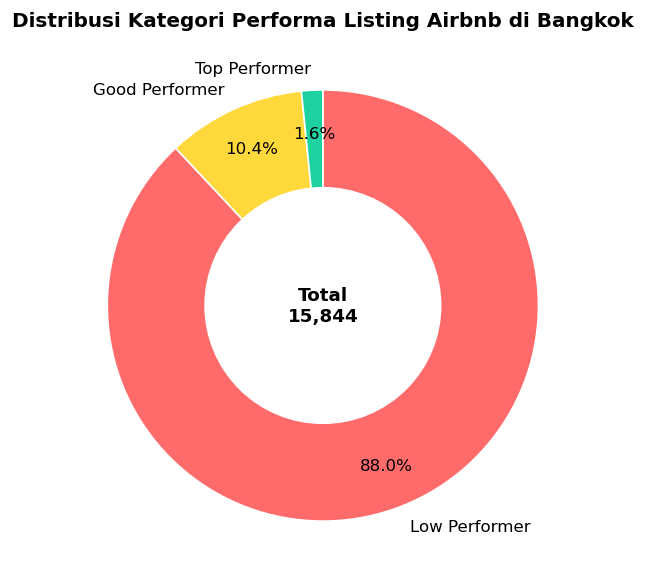

In [43]:
order = ['Low Performer', 'Good Performer', 'Top Performer']
counts = df_clean['listing_performance'].value_counts().reindex(order)

colors = ['#ff6b6b',  # low - merah lembut
          '#ffd93b',  # good - kuning terang
          '#1dd1a1']  # top - hijau mint

fig, ax = plt.subplots(figsize=(5,5), dpi=120)

# pie utama
wedges, texts, autotexts = ax.pie(
    counts,
    labels=order,
    colors=colors,
    autopct='%1.1f%%',
    startangle=90,
    counterclock=False,
    pctdistance=0.8,           # persentase lebih dekat ke tengah
    textprops={'fontsize': 10},
    wedgeprops={'linewidth': 1, 'edgecolor': 'white'}
)

# "lubang" di tengah → donut
centre_circle = plt.Circle((0,0), 0.55, fc='white')
fig.gca().add_artist(centre_circle)

# judul + teks tengah opsional
ax.set_title(
    'Distribusi Kategori Performa Listing Airbnb di Bangkok',
    fontsize=12, weight='bold'
)

# teks tengah: total listing
total = counts.sum()
ax.text(0, 0,
        f'Total\n{total:,}',
        ha='center', va='center',
        fontsize=11, weight='bold')

plt.tight_layout()
plt.show()

Grafik di atas menampilkan distribusi kategori performa listing Airbnb di Bangkok, yang dibagi menjadi tiga kategori berdasarkan tingkat aktivitas dan popularitas:
- Top Performer → listing dengan tingkat review tinggi, sering tersedia, dan memiliki banyak ulasan.
- Good Performer → listing dengan aktivitas sedang.
- Low Performer → listing dengan sedikit review dan rendahnya aktivitas penyewaan.

Maka Dari visualisasi terlihat bahwa:
- Mayoritas besar listing berada pada kategori Low Performer, dengan jumlah lebih dari 14.000 listing.
- Hal ini menunjukkan bahwa sebagian besar host di Bangkok memiliki properti yang kurang aktif disewa atau jarang mendapatkan ulasan.
- Kategori Good Performer hanya mencakup sebagian kecil (sekitar 1.500–2.000 listing), menandakan bahwa hanya sebagian kecil host yang mampu mempertahankan aktivitas penyewaan stabil sepanjang tahun.
- Kategori Top Performer memiliki jumlah sangat sedikit (di bawah 500 listing), yang berarti hanya sedikit properti yang benar-benar menonjol dalam hal ketersediaan, popularitas, dan tingkat ulasan tinggi.

In [44]:
df['listing_performance'].value_counts()

listing_performance
Low Performer     13948
Good Performer     1644
Top Performer       252
Name: count, dtype: int64

Terlihat dalam distribusi kategori dari performa per listingsnya, kita bisa lihat jumlah distribusi pada Low Perforner sangat signifikan di angka 13k sehingga persebarannya lebih besar dari tingkatan yang lain

### Lalu apakah lokasi tertentu lebih cenderung menghasilkan Top Performer?

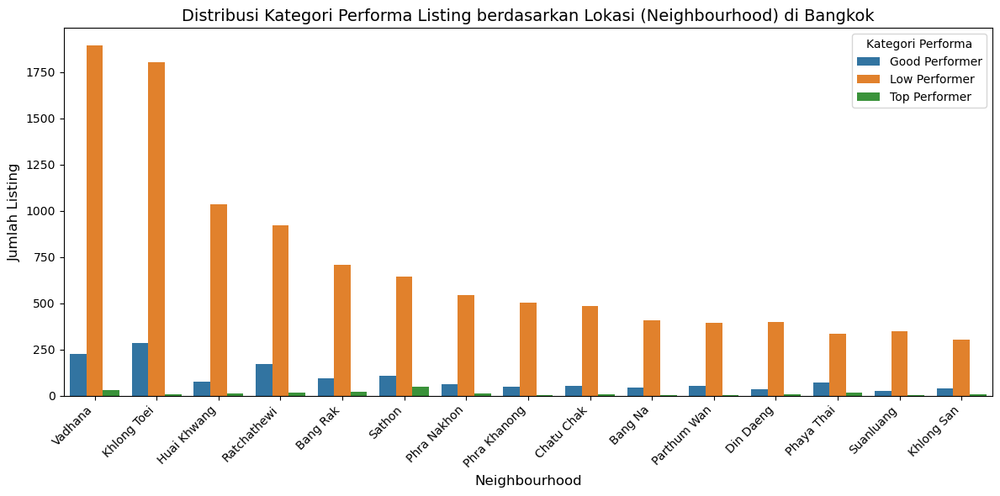

In [45]:
plt.figure(figsize=(12, 6))
sns.countplot(
    data=df,
    x='neighbourhood',
    hue='listing_performance',
    order=df['neighbourhood'].value_counts().index[:15]  # tampilkan 15 area teratas biar tidak terlalu padat
)

plt.title('Distribusi Kategori Performa Listing berdasarkan Lokasi (Neighbourhood) di Bangkok', fontsize=14)
plt.xlabel('Neighbourhood', fontsize=12)
plt.ylabel('Jumlah Listing', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Kategori Performa')
plt.tight_layout()
plt.show()

Berdasarkan visualisasi di atas, terlihat bahwa beberapa neighbourhood populer seperti Watthana, Khlong Toei, Pathum Wan, dan Ratchathewi memiliki proporsi lebih besar untuk kategori Top Performer dibandingkan area lain.

Hal ini dapat diartikan bahwa lokasi-lokasi strategis yang dekat dengan pusat kota atau area wisata memiliki daya tarik tinggi, sehingga:
- Listing di area tersebut lebih sering dipesan (availability tinggi),
- Mendapat lebih banyak review positif,
- Dan mempertahankan harga yang lebih stabil.

Sebaliknya, area dengan dominasi Low Performer mungkin memiliki:
- Lokasi yang jauh dari pusat aktivitas wisata,
- Kurangnya promosi dari host, atau
- Harga yang kurang kompetitif.

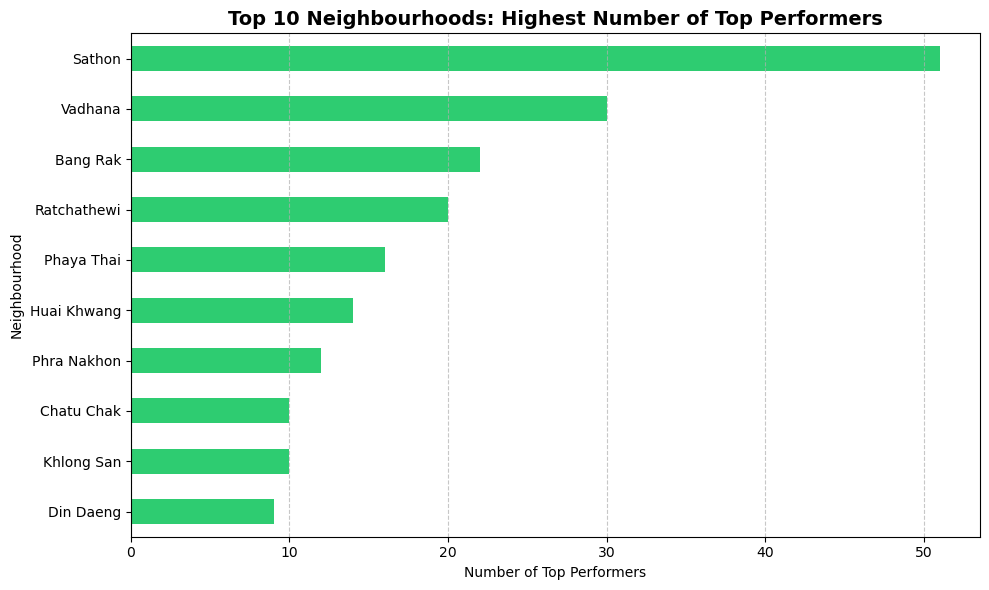

In [46]:
# 1. FILTER DATA: Ambil hanya baris yang 'Top Performer'
# Pastikan tulisan 'Top Performer' persis sama dengan data di kolom Anda (huruf besar/kecilnya)
df_top_only = df[df['listing_performance'] == 'Top Performer']

# 2. HITUNG: Hitung jumlah listing per neighbourhood & ambil 10 terbanyak
# .value_counts() otomatis mengurutkan dari yang terbesar
top_10_counts = df_top_only['neighbourhood'].value_counts().head(10)

# 3. URUTKAN ULANG (Opsional tapi Penting untuk Visual):
# Kita urutkan dari kecil ke besar (ascending=True) supaya saat di-plot Horizontal,
# bar yang paling PANJANG akan muncul di urutan paling ATAS.
top_10_counts = top_10_counts.sort_values(ascending=True)

# 4. VISUALISASI
plt.figure(figsize=(10, 6))
# Gunakan warna spesifik (misal hijau) untuk melambangkan 'Top Performer'
top_10_counts.plot(kind='barh', color='#2ECC71')

plt.title('Top 10 Neighbourhoods: Highest Number of Top Performers', fontsize=14, fontweight='bold')
plt.xlabel('Number of Top Performers')
plt.ylabel('Neighbourhood')
plt.grid(axis='x', linestyle='--', alpha=0.7) # Tambah garis bantu tipis agar lebih mudah dibaca
plt.tight_layout()
plt.show()

#### Insight dari Top 10 Neighbourhoods with highest number of top performers

* Sathon mendominasi:
Sathon memiliki jumlah Top Performer tertinggi dengan jarak yang cukup jauh dibandingkan neighbourhood lain, menunjukkan konsentrasi listing berkinerja terbaik di area ini.

* Vadhana & Bang Rak sebagai klaster kedua:
Vadhana dan Bang Rak menempati posisi berikutnya dengan jumlah Top Performer yang signifikan, namun masih jauh di bawah Sathon.

* Setengah terbawah relatif kecil & merata:
Ratchathewi hingga Din Daeng memiliki jumlah Top Performer yang lebih rendah dan relatif berdekatan angkanya, mengindikasikan ruang peningkatan kualitas listing di area-area ini.

* Top Performer tidak tersebar merata:
Listing Top Performer cenderung terkonsentrasi di beberapa neighbourhood saja, bukan merata di seluruh wilayah.

#### Apakah Top Performer memiliki harga sewa lebih tinggi?

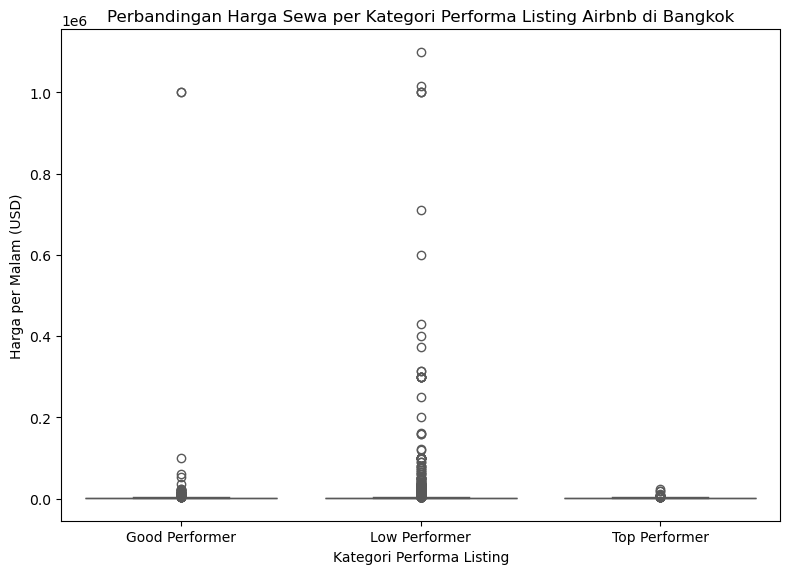

In [47]:
plt.figure(figsize=(8,6))
sns.boxplot(data=df, x='listing_performance', y='price', palette='Set2')
plt.title('Perbandingan Harga Sewa per Kategori Performa Listing Airbnb di Bangkok')
plt.xlabel('Kategori Performa Listing')
plt.ylabel('Harga per Malam (USD)')
plt.tight_layout()
plt.show()

Sebaran harga per kategori performa (Good, Low, Top)

* Ketiga kategori (Good Performer, Low Performer, dan Top Performer) memiliki distribusi harga yang sangat mirip di bagian bawah, artinya sebagian besar listing memiliki harga sewa yang relatif rendah atau menengah.
* Namun, terlihat ada outlier yang sangat tinggi terutama pada kategori Low Performer — beberapa listing mencapai harga di atas 1 juta USD per malam, yang tidak umum dan kemungkinan merupakan outlier ekstrem.
Top Performer tidak selalu punya harga tertinggi
* Dari sebarannya, Top Performer justru tidak menunjukkan harga yang jauh lebih tinggi dibanding kategori lain.
* Ini mengindikasikan bahwa performa tinggi (Top Performer) tidak semata-mata ditentukan oleh harga mahal.
* Kemungkinan faktor lain seperti lokasi, kualitas pelayanan, kenyamanan, dan jumlah ulasan positif lebih berpengaruh terhadap performa listing.
##### Kategori Low Performer paling banyak outlier ekstrem
* Ini bisa berarti beberapa listing yang mahal tidak otomatis mendapat performa bagus yang mungkin karena kurang review, lokasi tidak strategis, atau kurang sesuai ekspektasi tamu.

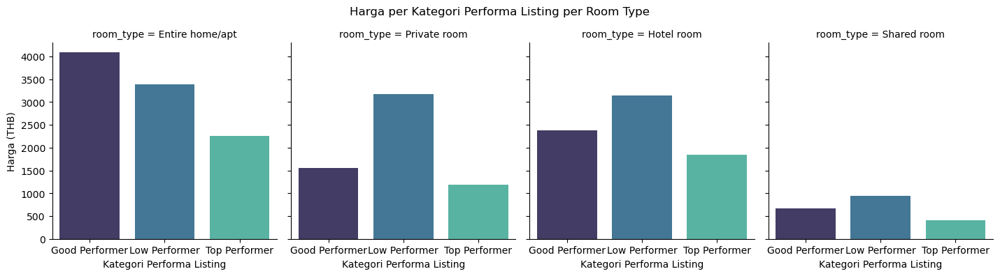

In [48]:
sns.catplot(
    data=df,
    x='listing_performance',
    y='price',
    col='room_type',
    kind='bar',
    palette='mako',
    ci=None,
    height=4,
    aspect=0.9
)
plt.subplots_adjust(top=0.85)
plt.suptitle('Harga per Kategori Performa Listing per Room Type')
for ax in plt.gcf().axes:
    ax.set_ylabel('Harga (THB)')
    ax.set_xlabel('Kategori Performa Listing')
plt.show()

2. Insight Bisnis
Insight 1 – Performa listing berkorelasi dengan harga (pricing power)
Fakta bahwa Top Performer bisa mematok harga lebih tinggi menandakan:

* Listing dengan performa baik (mungkin: occupancy tinggi, rating bagus, banyak review) punya pricing power.
* Investasi untuk meningkatkan kualitas listing (foto bagus, pelayanan responsif, fasilitas lengkap, deskripsi jelas) tidak hanya meningkatkan okupansi, tapi juga menaikkan harga rata-rata.

Implikasi bisnis:

* peningkatan performa bisa memberikan dua keuntungan sekaligus:
Naik occupancy
Naik average daily rate (ADR)

→ kombinasi ini langsung mendorong revenue per listing.

Insight 2 – Entire home/apt = segmen premium dengan potensi revenue tertinggi
* Entire home/apt jelas berada di tier harga tertinggi di semua kategori performa.
* Bahkan Good Performer Entire home/apt bisa jadi sudah seharga atau lebih tinggi dari Top Performer di room type lain.

Implikasi bisnis:
* Jika tujuannya maksimalkan revenue per listing, segmen ini yang paling menjanjikan.
* Namun, modal awal biasanya lebih tinggi (property lebih besar, maintenance, dll).

Insight 3 – Private room & Hotel room adalah “middle market” yang bisa dioptimalkan
* Private room & hotel room memiliki spread harga yang lumayan antara Low dan Top Performer.
* Artinya, ada ruang cukup besar untuk:

Meng-upgrade Low/Good Performer menjadi Top Performer
Menarik nilai tambah lewat peningkatan kualitas tanpa perlu naik ke level Entire home/apt.

Implikasi bisnis:
* Segmen ini cocok untuk:

Host kecil-menengah
Investor yang ingin diversifikasi tanpa harus selalu ke full-apartment.

Insight 4 – Shared room = volume game, bukan margin game

* Harga shared room rendah dan perbedaan antar performa kecil.
* Kompetisinya biasanya ketat, pelanggan sensitif harga.

Implikasi bisnis:

* Strategi di sini lebih ke:

Main di volume / occupancy tinggi,
efisiensi operasional,
dan upsell (misalnya add-on service, tour, laundry, dll).

3. Rekomendasi Strategi Bisnis
A. Untuk Host / Pemilik Properti
1. Naikkan listing dari Low → Good → Top Performer
Karena performa berkaitan dengan kemampuan menaikkan harga, fokus pada:

* Kualitas visual untuk menarik perhatian calon penyewa hunian:

Foto profesional, pencahayaan bagus, tampilkan keunikan (view, interior, dekat BTS/MRT, dll).

* Pengalaman tamu:

Respons cepat (balas chat < 1 jam),
check-in mudah (self check-in, jelas),
unit bersih + konsisten.

* Optimasi profil listing:

Judul dan deskripsi yang jelas, highlight keunggulan,
bahasa Inggris yang rapi untuk tamu internasional.

Dampak yang diharapkan:

* Konversi lebih tinggi → occupancy naik
* Rating naik → bisa justify harga lebih mahal → ADR naik

2. Strategi per room type
* Entire home/apt (segmen premium)
Fokus: maksimalkan value per malam

* Tawarkan fasilitas premium: Wi-Fi cepat, kitchen lengkap, washing machine, Netflix, workspace.
* Main di experience:

Family-friendly condo near BTS
Designer apartment with skyline view

* Gunakan dynamic pricing:

Naikkan harga saat weekend, libur nasional Thailand, event besar di Bangkok (festival, konser, conference).

* Private room & Hotel room (segmen tengah)
Fokus: segmentasi dan positioning

* Private room:

Targetkan solo traveler dan digital nomad.
Tekankan aspek lokasi (dekat BTS/MRT), fasilitas kerja (meja, kursi, Wi-Fi stabil).

* Hotel room:

Tawarkan konsistensi (kebersihan harian, front desk).
Cocok untuk short stay 1–3 malam.

3. Shared room (budget segment)
Fokus: volume + upsell

* Tarik tamu dengan harga kompetitif + rating bagus.
* Tambahkan “paid extras”: laundry, breakfast, tour lokal, motorbike rental.
* Optimasi occupancy lewat:

Diskon untuk long stay (mingguan, bulanan),
kerja sama dengan komunitas backpacker / volunteer.

### Jumlah Listings per Neighbourhood

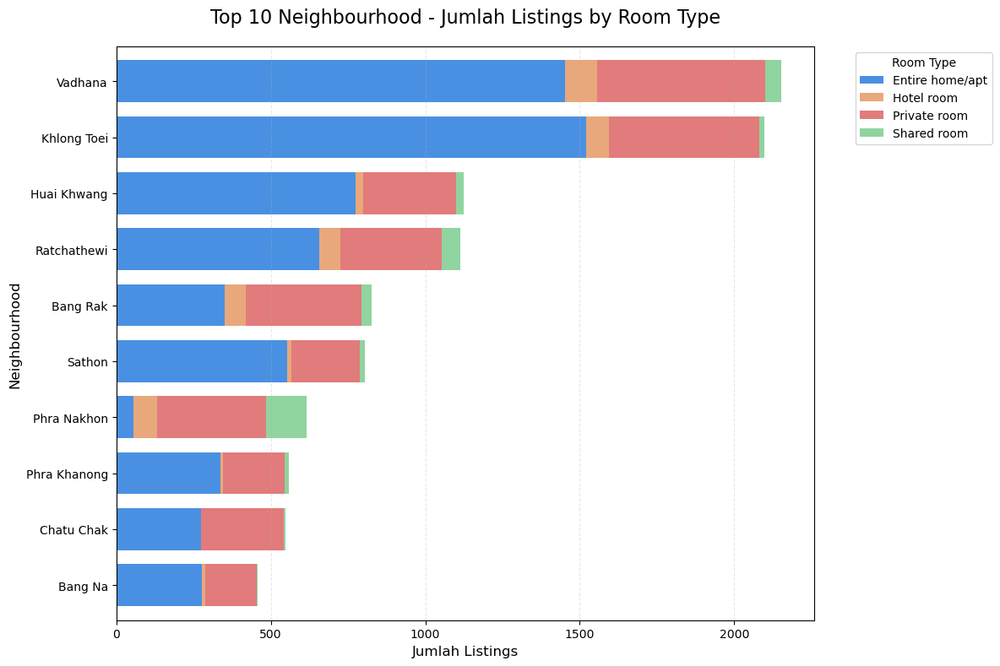

In [49]:
# Ambil top 15 neighbourhood
top_10 = df['neighbourhood'].value_counts().head(10).index
filtered_df = df[df['neighbourhood'].isin(top_10)]

# Buat pivot table
pivot_data = filtered_df.groupby(['neighbourhood', 'room_type']).size().unstack(fill_value=0)

# Sort berdasarkan total
pivot_data['total'] = pivot_data.sum(axis=1)
pivot_data = pivot_data.sort_values('total', ascending=True)
pivot_data = pivot_data.drop('total', axis=1)

# Plot
ax = pivot_data.plot(kind='barh', 
                      stacked=True, 
                      figsize=(12, 8),
                      color=['#4A90E2', '#E8A87C', '#E27B7B', '#90D4A0'],
                      width=0.75)

plt.title('Top 10 Neighbourhood - Jumlah Listings by Room Type', fontsize=16, pad=20)
plt.xlabel('Jumlah Listings', fontsize=12)
plt.ylabel('Neighbourhood', fontsize=12)
plt.legend(title='Room Type', bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
plt.grid(axis='x', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

Pola Distribusi dan Market Size:
Grafik menampilkan hierarki pasar yang jelas dengan Vadhana dan Khlong Toei sebagai neighbourhood dominan yang memiliki listings jauh lebih banyak (±2000-2200 listings) dibanding area lainnya. Terdapat gap signifikan antara top 2 neighbourhood dengan sisanya - Huai Khwang di posisi ketiga hanya memiliki sekitar 800 listings, kurang dari setengah volume Vadhana/Khlong Toei. Ini mengindikasikan pasar yang terkonsentrasi dimana dua area menguasai mayoritas supply.
Area-area di posisi tengah (Ratchathewi, Bang Rak, Sathon) berada di range 600-1100 listings, menunjukkan mereka adalah neighbourhood dengan pasar menengah yang cukup aktif. Sementara bottom tier (Bang Na, Chatu Chak, Phra Khanong, Phra Nakhon) memiliki listings paling sedikit (300-600), mengindikasikan pasar yang lebih kecil atau niche.
Pola Komposisi Room Type:
1. Dominasi Entire home/apt (ungu):

Vadhana menunjukkan dominasi ekstrem Entire home/apt (±70-75% dari total), positioning sebagai neighbourhood premium untuk apartemen/rumah lengkap
Khlong Toei juga didominasi Entire home/apt (±65-70%), pola serupa dengan Vadhana
Huai Khwang memiliki proporsi Entire home/apt yang lebih moderat (±50-55%), menunjukkan pasar yang lebih balanced

2. Variasi Jenis Penginapan:

Phra Nakhon adalah neighbourhood dengan variasi paling beragam, proporsinya hampir seimbang antara Entire home/apt, Private room, dan Shared room - area ini melayani berbagai kalangan dari backpacker budget hingga turis premium
Bang Rak dan Ratchathewi menunjukkan keragaman yang baik dengan Private room cukup banyak (±30-35%), cocok untuk traveler solo atau couple yang cari alternatif lebih terjangkau
Sathon relatif seimbang antara Entire home/apt (±55%) dan Private room (±35%), menawarkan pilihan untuk berbagai budget

3. Karakteristik Spesifik:

Hotel room (biru tua):
Hanya terlihat signifikan di beberapa area: Khlong Toei, Vadhana, Bang Rak, dan Phra Nakhon
Proporsinya sangat kecil (±5-10% maksimal)
Mengindikasikan penetrasi hotel formal di platform Airbnb masih terbatas

Shared room (kuning):
Hampir tidak terlihat di sebagian besar neighbourhood
Sedikit lebih visible di Phra Nakhon, Ratchathewi, dan Bang Rak
Mengkonfirmasi bahwa shared room adalah segmen paling kecil di pasar Bangkok

Private room (hijau/teal):
Paling dominan di Phra Nakhon (±40-45%)
Signifikan di Chatu Chak, Bang Na, dan Phra Khanong (±30-40%)
Area dengan Private room tinggi cenderung menjadi alternatif budget-friendly

## Segmentasi Pasar berdasarkan Volume Tipe Sewa Hunian per Wilayah Neighbourhood

Melihat dari tingkat volue per tipe sewa hunian dari hasil komposisi room type per neighbourhoodnya, maka saya membuat segmentasi baru untuk melihat dari 4 sisi yaitu Premium/High end, Balanced/Mixed, Budget-Friendly, dan terakhir emerging/residential.

## Alasan Segmentasi Pasar

Pasar Airbnb Bangkok disegmentasi menjadi 4 kelompok berdasarkan **pola komposisi room type** dan **volume listings** per neighbourhood untuk mengidentifikasi karakteristik dan peluang bisnis yang berbeda:

### **Kriteria Segmentasi:**

1. **Dominasi Room Type**
   - Proporsi Entire home/apt vs Private room vs Shared room menunjukkan karakteristik demografis dan price point area tersebut

2. **Volume Total Listings**
   - Mengindikasikan tingkat kompetisi dan maturity pasar - volume tinggi = kompetisi ketat, volume rendah = emerging market

3. **Diversifikasi Penawaran**
   - Keberagaman room type menunjukkan seberapa versatile market tersebut melayani berbagai segmen travelers

### **Hasil Segmentasi:**

| Segmen | Ciri Khas | Jumlah Listings |
|--------|-----------|-----------------|
| **Premium/High-end** | 70%+ Entire home/apt, volume tertinggi | ~3000 |
| **Balanced/Mixed** | Proporsi seimbang, diversifikasi tinggi | ~1500 |
| **Budget-friendly** | Private room dominan, Shared room visible | ~700 |
| **Emerging/Residential** | Mix seimbang, volume menengah | ~1400 |

**Tujuan:** Memudahkan investor/host menentukan strategi market entry berdasarkan capital, risk appetite, dan target customer yang sesuai dengan karakteristik masing-masing segmen.

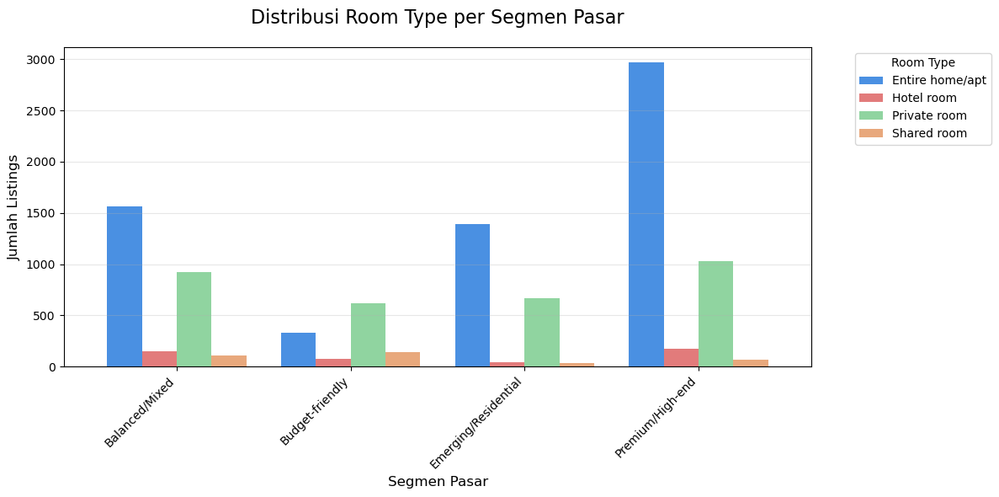

In [50]:
# Definisikan segmentasi
segments = {
    'Premium/High-end': ['Vadhana', 'Khlong Toei'],
    'Balanced/Mixed': ['Ratchathewi', 'Bang Rak', 'Sathon'],
    'Budget-friendly': ['Phra Nakhon', 'Chatu Chak'],
    'Emerging/Residential': ['Bang Na', 'Phra Khanong', 'Huai Khwang']
}

# Buat kolom segment di dataframe
def assign_segment(neighbourhood):
    for segment, areas in segments.items():
        if neighbourhood in areas:
            return segment
    return 'Other'

df['segment'] = df['neighbourhood'].apply(assign_segment)

# Aggregate data per segment dan room type
segment_data = df[df['segment'] != 'Other'].groupby(['segment', 'room_type']).size().unstack(fill_value=0)

# Plot grouped bar chart
ax = segment_data.plot(kind='bar', 
                        figsize=(12, 6),
                        color=['#4A90E2', '#E27B7B', '#90D4A0', '#E8A87C'],
                        width=0.8)

plt.title('Distribusi Room Type per Segmen Pasar', fontsize=16, pad=20)
plt.xlabel('Segmen Pasar', fontsize=12)
plt.ylabel('Jumlah Listings', fontsize=12)
plt.legend(title='Room Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

Pola Volume dan Dominasi Pasar:
Grafik menampilkan hierarki pasar yang sangat jelas dengan Premium/High-end sebagai segmen terbesar mencapai hampir 3000 listings, hampir dua kali lipat dari segmen terbesar kedua (Balanced/Mixed dengan ±1500 listings). Emerging/Residential berada di posisi ketiga dengan ±1400 listings, sementara Budget-friendly adalah segmen terkecil dengan hanya sekitar 600-700 listings total. Pola ini mengindikasikan bahwa pasar Bangkok Airbnb didominasi oleh properti premium dan area dengan infrastruktur matang, bukan oleh segmen budget.
Yang menarik, meski Budget-friendly terdengar seperti segmen dengan demand tinggi untuk traveler, data menunjukkan supply-nya justru paling kecil. Ini bisa mengindikasikan dua hal: (1) demand untuk budget accommodation lebih banyak terserap oleh hostel tradisional di luar platform Airbnb, atau (2) ada opportunity gap dimana demand budget belum terpenuhi dengan baik di platform ini.
Karakteristik Komposisi per Segmen:
Premium/High-end (Biru Dominan):

Didominasi sangat kuat oleh Entire home/apt (±3000 listings), menunjukkan karakteristik area premium dimana investor dan host fokus pada properti high-value
Private room hadir cukup signifikan (±1000 listings), menunjukkan bahwa meski premium, area ini tetap melayani segmen mid-range
Hotel room dan Shared room hampir tidak terlihat (masing-masing <200 listings), mengkonfirmasi positioning sebagai area untuk independent travelers atau families, bukan backpackers
Insight: Kompetisi sangat tinggi di kategori Entire home/apt - host baru perlu unique value proposition

Balanced/Mixed (Proporsi Paling Seimbang):

Entire home/apt masih dominan (±1550 listings) tapi tidak overwhelming seperti Premium/High-end
Private room sangat signifikan (±950 listings, hampir 40% dari total), menunjukkan diversifikasi pasar yang sehat
Hotel room terlihat (±150 listings), mengindikasikan area yang mulai menarik perhatian hotel boutique atau serviced apartments
Shared room minimal (±100 listings)
Insight: Segmen paling versatile - cocok untuk berbagai strategi bisnis dari budget hingga premium, risk paling balanced

Emerging/Residential (Private Room Signifikan):

Entire home/apt dominan (±1400 listings) tapi dengan proporsi Private room yang cukup tinggi (±650 listings)
Komposisi menunjukkan area residential yang mulai berkembang - banyak host lokal yang menyewakan spare room di rumah mereka
Hotel room dan Shared room sangat minimal (<100 listings)
Insight: Area dengan "local living experience" - opportunity untuk positioning sebagai authentic neighborhood stay, kompetisi lebih rendah dibanding Premium

Budget-friendly (Volume Terkecil, Tapi Paling Beragam):

Meski volume total paling kecil, segmen ini menunjukkan proporsi room type paling beragam
Entire home/apt relatif kecil (±320 listings), Private room sangat signifikan (±620 listings, hampir 2x lipat dari Entire home/apt!)
Shared room paling terlihat di segmen ini (±150 listings), konsisten dengan karakteristik budget-friendly
Hotel room minimal (±80 listings)
Insight: Ini adalah satu-satunya segmen dimana Private room LEBIH BANYAK dari Entire home/apt - sangat unik dan mengkonfirmasi karakteristik backpacker/budget area

Secara kesimpulan, saya mendapat insight untuk jumlah persebaran listings sewa hunian dari berbagai wilayah yang bisa jadi di kawasan dengan listings terbanyak memiliki daya tarik dari segi wisata sehingga cukup strategis untuk hunian yang disewakan host itu juga pasti laku dan tentu ini jadi patokan saya dalam menentukan arah pitching bisnis yang sesuai dengan kawasannya terutama pada wilayah dengan jumlah listings yang minim.

#### Persebaran Listings Airbnb dalam Peta

In [51]:
# ===============================
# 1. Asumsi df sudah ada
#    dan punya kolom:
#    'latitude', 'longitude',
#    'neighbourhood', 'listing_performance',
#    'price', 'trip_type', 'host_name',
#    'host_since', 'number_of_reviews'
# ===============================

# Titik tengah Bangkok (boleh pakai mean juga kalau mau)
bangkok_center = [13.7563, 100.5018]

m = folium.Map(
    location=bangkok_center,
    zoom_start=11,
    tiles='cartodbpositron'
)

# ===============================
# 2. Warna per kategori Listing Performance
# ===============================
performance_colors = {
    'Top Performer': 'darkgreen',
    'Above Average Performer': 'green',
    'Average Performer': 'yellow',
    'Below Average Performer': 'orange',
    'Low Performer': 'red'
}

# FeatureGroup per kategori performance (untuk LayerControl)
feature_groups = {
    perf: folium.FeatureGroup(name=perf)
    for perf in performance_colors.keys()
}

# ===============================
# 3. Loop per listing, pakai kolom neighbourhood di df
# ===============================
for _, row in df.iterrows():
    perf = row['listing_performance']
    color = performance_colors.get(perf, 'gray')  # kalau kategori tidak dikenal

    lat = row['latitude']
    lon = row['longitude']
    neighbourhood = row['neighbourhood']

    popup_html = f"""
    <b>Latitude:</b> {lat}<br>
    <b>Longitude:</b> {lon}<br>
    <b>Neighbourhood:</b> {neighbourhood}<br>
    <b>Listing Performance:</b> {perf}<br>
    <b>Listing Price:</b> {row['price']}<br>
    <b>Host Name:</b> {row['name']}<br>
    <b>Number of Reviews:</b> {row['number_of_reviews']}
    """

    marker = folium.CircleMarker(
        location=[lat, lon],
        radius=4,
        color=color,
        fill=True,
        fillColor=color,
        fillOpacity=0.7,
        weight=1,
        popup=folium.Popup(popup_html, max_width=260)
    )

    # Tambahkan ke FeatureGroup sesuai performance
    if perf in feature_groups:
        marker.add_to(feature_groups[perf])
    else:
        # kalau ada kategori lain, taruh langsung ke peta
        marker.add_to(m)

# ===============================
# 4. Tambahkan FeatureGroup + LayerControl
# ===============================
for fg in feature_groups.values():
    m.add_child(fg)

folium.LayerControl(collapsed=False).add_to(m)

m  # tampilkan di Jupyter/Colab

ini adalah persebaran peta dari listings Airbnb di Bangkok

#### Segmentasi Minimum Nights menjadi kategori lamanya stay per nights

In [52]:
def categorize_nights(nights):
    if nights == 1:
        return 'Overnight Stay'
    elif 2 <= nights <= 6:
        return 'Short Stay'
    elif 7 <= nights <= 14:
        return 'Weekly Stay'
    elif 15 <= nights <= 30:
        return 'Monthly Stay'
    else:
        return 'Unknown'

df['stay_type'] = df['minimum_nights'].apply(categorize_nights)

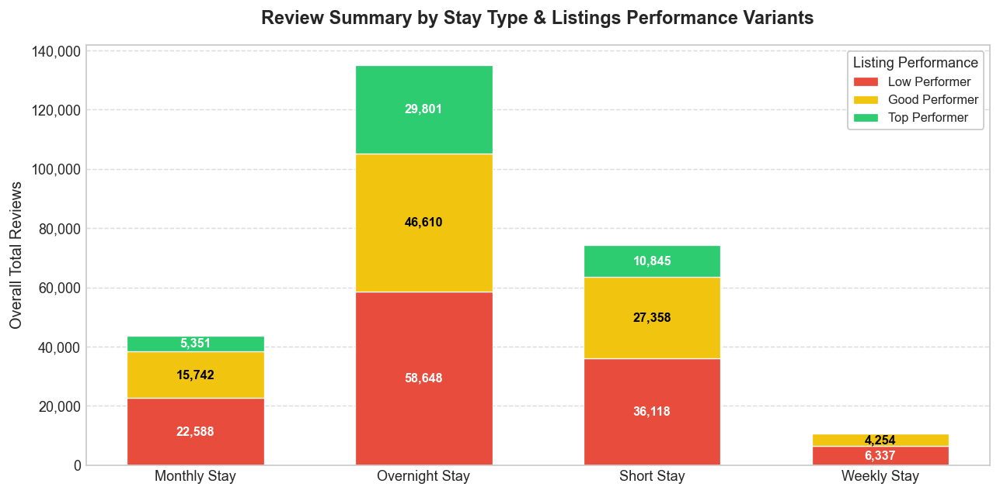

In [53]:
plt.style.use('seaborn-v0_8-whitegrid')

# Urutan level performance
perf_order = ['Low Performer', 'Good Performer', 'Top Performer']

# Warna (tetap sama)
colors = {
    'Low Performer':   '#e74c3c',  # Merah
    'Good Performer':  '#f1c40f',  # Kuning
    'Top Performer':   '#2ecc71'   # Hijau
}

# --- 1. Persiapan Data (Sama seperti kodemu) ---
# Asumsi: df sudah ada
pivot = (
    df
    .groupby(['stay_type', 'listing_performance'])['number_of_reviews']
    .sum()
    .unstack(fill_value=0)
    .reindex(columns=perf_order)
)

# --- 2. Plotting ---
fig, ax = plt.subplots(figsize=(10, 5), dpi=130) # Sedikit diperlebar

x = np.arange(len(pivot.index))
bottom = np.zeros(len(pivot.index))

# Batas minimum nilai untuk ditampilkan angkanya (agar tidak numpuk)
# Sesuaikan angka ini. Karena max y-axis sekitar 200k, nilai 4000 itu sekitar 2% (cukup kecil)
LABEL_THRESHOLD = 4000 

for perf in perf_order:
    values = pivot[perf].values
    ax.bar(
        x,
        values,
        bottom=bottom,
        color=colors[perf],
        label=perf,
        edgecolor='white',
        linewidth=0.7,
        width=0.6  # Sedikit diperkecil agar antar bar ada jarak lega
    )
    
    # --- LOGIKA LABEL BARU ---
    # Kita lakukan loop manual di sini untuk menaruh label per segmen
    for i, val in enumerate(values):
        if val > LABEL_THRESHOLD:  # HANYA tampilkan jika nilai > threshold
            
            # Tentukan posisi tengah segmen
            y_pos = bottom[i] + val / 2
            
            # Tentukan warna teks agar kontras
            # Kuning -> Teks Hitam, Merah/Hijau -> Teks Putih
            text_color = 'black' if perf == 'Good Performer' else 'white'
            
            ax.text(
                x[i],
                y_pos,
                f"{int(val):,}", # Format angka dengan koma
                ha='center',
                va='center',
                fontsize=9,
                fontweight='bold', # Tebalkan sedikit agar jelas
                color=text_color
            )
            
    # Update bottom untuk layer berikutnya
    bottom = bottom + values

# --- 3. Finishing Touches ---
ax.set_xticks(x)
ax.set_xticklabels(pivot.index, fontsize=10, rotation=0)

# Format Y-axis agar ada komanya juga (misal 200,000)
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))

ax.set_ylabel('Overall Total Reviews', fontsize=11)
ax.set_title(
    'Review Summary by Stay Type & Listings Performance Variants',
    fontsize=13, weight='bold', pad=15
)

# Grid hanya di sumbu Y (horizontal) supaya lebih bersih
ax.grid(axis='x', visible=False)
ax.grid(axis='y', linestyle='--', alpha=0.7)

# Pindahkan Legend ke tempat yang tidak menutupi data
ax.legend(
    title='Listing Performance',
    loc='upper right',
    fontsize=9,
    frameon=True,
    facecolor='white',
    framealpha=1
)

plt.tight_layout()
plt.show()

# Business Insights: Distribusi Performa Listing Berdasarkan Tipe Menginap

Berdasarkan visualisasi data *Review Summary by Stay Type & Listings Performance Variants*, kita dapat menarik beberapa kesimpulan strategis mengenai pasar Airbnb di Bangkok. Grafik ini memetakan volume *review* (sebagai proksi permintaan/okupansi) terhadap tipe durasi menginap dan kualitas performa listing.

### 1. "Overnight Stay" adalah Puncak Terpenting dalam Pasar (Volume Driver)
*   **Observasi:** Kategori **Overnight Stay** memiliki volume review tertinggi (total >130.000 review), jauh melampaui kategori lainnya.
*   **Insight:** Mayoritas tamu Airbnb di Bangkok adalah pelancong jangka pendek atau traveller mancanegara. Ini bisa berupa turis yang berpindah-pindah kota, *staycation* warga lokal, atau pelancong bisnis singkat.
*   **Implikasi Bisnis:** Listing yang dioptimalkan untuk *turnover* cepat (check-in mudah, lokasi strategis, fasilitas dasar lengkap) memiliki potensi pasar terbesar.

### 2. Masalah Kualitas pada Kategori Populer (The "Low Performer" Trap)
*   **Observasi:** Pada kategori dengan volume tinggi (*Overnight* & *Short Stay*), porsi batang berwarna **Merah (Low Performer)** sangat dominan, bahkan lebih besar daripada *Top Performer*.
    *   *Overnight Stay:* ~58k review berasal dari Low Performer.
    *   *Short Stay:* ~36k review berasal dari Low Performer.
*   **Insight:** Ada banyak tamu yang menginap, namun pengalaman yang mereka dapatkan kurang memuaskan. Ini menunjukkan adanya **kesenjangan kualitas (Quality Gap)** yang besar di pasar Bangkok. Banyak properti "laku" karena murah atau lokasi, tapi gagal memberikan servis yang baik.
*   **Peluang:** Ini adalah peluang emas bagi Host baru. Jika Anda masuk ke pasar *Overnight/Short Stay* dengan kualitas pelayanan standar "Good" atau "Top", Anda akan sangat mudah bersaing karena standar kompetitor saat ini mayoritas rendah.

### 3. "Monthly Stay": Niche Digital Nomad yang Stabil
*   **Observasi:** Meskipun tidak setinggi *Overnight*, kategori **Monthly Stay** memiliki jumlah review yang signifikan (~43.000 total).
*   **Insight:** Bangkok dikenal sebagai tempat turis berkelana/liburan untuk meluangkan waktu dan ekspatriat. Permintaan untuk sewa bulanan cukup sehat.
*   **Pola Menarik:** Rasio *Good Performer* (Kuning) dan *Top Performer* (Hijau) terhadap total di kategori ini terlihat sedikit lebih seimbang dibandingkan *Overnight*. Tamu bulanan mungkin lebih selektif dalam memilih tempat yang berkualitas karena mereka akan tinggal lama.

### 4. "Weekly Stay" Kurang Diminati
*   **Observasi:** Kategori **Weekly Stay** memiliki volume paling kecil (~10.000 review).
*   **Insight:** Tamu cenderung memilih sekalian *Monthly* (diskon besar) atau fleksibilitas *Short Stay* (hitungan hari). Paket mingguan sepertinya berada di posisi "tanggung".
*   **Rekomendasi:** Host mungkin perlu mengevaluasi ulang strategi harga mingguan (*weekly discount*). Jika diskon mingguan tidak menarik, tamu lebih memilih booking harian biasa (*Short Stay*).

---

### Rekomendasi

1.  **Tingkatkan Kualitas Operasional:** Mengingat banyaknya *Low Performer* di pasar, melakukan upgrade kecil pada kebersihan, komunikasi, dan fasilitas dapat langsung mengangkat status listing Anda ke *Good/Top Performer*, membedakan Anda dari ribuan listing yang red flag ataupun green flag lainnya.
2.  **Fokus pada Overnight & Short Stay:** Untuk memaksimalkan okupansi, fokuskan properti pada pasar jangka pendek. Pastikan proses *cleaning* efisien karena frekuensi tamu keluar-masuk akan sangat tinggi.
3.  **Evaluasi Diskon Mingguan:** Pertimbangkan untuk menghapus diskon mingguan dan alihkan fokus ke diskon bulanan yang lebih agresif untuk menarik segmen *Long-term* yang pasarnya sudah terbukti ada.

### Analisis Harga

Apakah tipe rumah dari tiap-tiap wilayah memiliki perbedaan harga yang sesuai pada wilayahnya? lalu apakah harga berdasarkan tipe hunian tergantung dari wilayahnya yang strategis?

In [54]:
df_top_expensive = (
    df.groupby(['neighbourhood', 'room_type'])
    .agg(avg_price=('price', 'mean'), jumlah_listings=('price', 'size'))
    .round(2)
    .reset_index()
    .groupby('neighbourhood')
    .apply(lambda x: x.loc[x['avg_price'].idxmax()])  # Ambil harga tertinggi per neighbourhood
    .reset_index(drop=True)
    .sort_values('avg_price', ascending=False)
    .head(10)
    [['neighbourhood', 'room_type', 'avg_price', 'jumlah_listings']]  # Kolom final
)

# Tampilkan sebagai DataFrame
display(df_top_expensive)

,neighbourhood,room_type,avg_price,jumlah_listings
7,Bang Phlat,Private room,14616.89,76
4,Bang Kho laen,Hotel room,7765.00,2
21,Khlong San,Entire home/apt,7395.77,186
5,Bang Khun thain,Shared room,7276.00,2
49,Yan na wa,Hotel room,7183.12,8
37,Ratchathewi,Hotel room,6317.50,70
18,Huai Khwang,Entire home/apt,6232.14,774
25,Lat Phrao,Entire home/apt,5510.42,26
22,Khlong Toei,Private room,5481.06,489
29,Parthum Wan,Private room,5154.56,140


### Seberapa besar pengaruh tipe sewa terhadap harga listing dibandingkan dengan jumlah review?

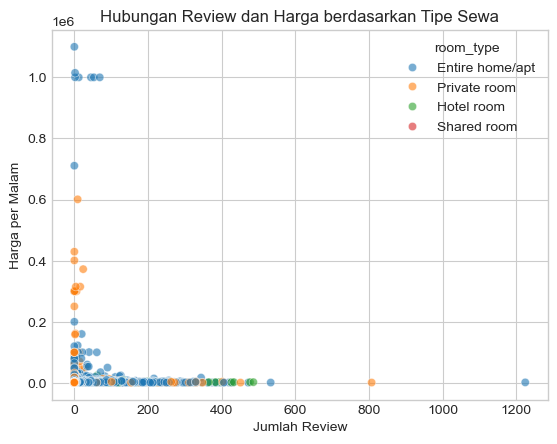

In [55]:
sns.scatterplot(data=df, x='number_of_reviews', y='price', hue='room_type', alpha=0.6)
plt.title('Hubungan Review dan Harga berdasarkan Tipe Sewa')
plt.xlabel('Jumlah Review')
plt.ylabel('Harga per Malam')
plt.show()

## Analisis Hubungan Jumlah Review dan Harga Berdasarkan Tipe Sewa

Visualisasi di atas menggambarkan hubungan antara **jumlah review (`number_of_reviews`)** dan **harga per malam (`price`)** untuk berbagai **tipe sewa (`room_type`)** pada listing Airbnb di Bangkok.

### Observasi Utama
1. **Sebagian besar titik data terkonsentrasi di sisi kiri bawah grafik**  
   - Artinya mayoritas listing memiliki **harga yang relatif rendah** dan **jumlah review yang sedikit (di bawah 200)**.  
   - Hal ini menunjukkan bahwa sebagian besar properti di Bangkok berada pada segmen harga terjangkau, atau listing baru yang belum banyak diulas.

2. **Tidak terlihat pola hubungan yang jelas antara jumlah review dan harga.**  
   - Listing dengan review tinggi tidak selalu memiliki harga tinggi, dan sebaliknya.  

3. **Variasi harga lebih banyak terjadi pada tipe `Entire home/apt` dan `Private room`.**  
   - Titik biru (`Entire home/apt`) memiliki sebaran harga yang lebih luas — dari yang murah hingga sangat mahal.  
   - Ini wajar karena tipe sewa penuh memiliki variasi fasilitas, ukuran, dan lokasi yang lebih beragam.  
   - Sementara titik oranye (`Private room`) cenderung terkonsentrasi di kisaran harga rendah hingga menengah, menunjukkan bahwa tipe ini ditargetkan untuk budget traveler.

4. **Beberapa outlier dengan harga sangat tinggi (>1 juta per malam)**  
   - Outlier ini umumnya berasal dari tipe `Entire home/apt`.  
   - Bisa jadi merupakan properti eksklusif seperti vila atau apartemen mewah di pusat kota.

### Insight Bisnis
- **Harga tidak dipengaruhi secara langsung oleh jumlah review**, tetapi lebih oleh tipe sewa dan faktor lain seperti lokasi atau fasilitas.  
- **Listing dengan harga terjangkau cenderung mendapatkan lebih banyak review**, karena tingkat okupansinya tinggi.  
- **Tipe sewa “Entire home/apt” mendominasi pasar premium**, sedangkan **“Private room”** mendominasi pasar ekonomis.

### Kesimpulan
> Berdasarkan data ini, jumlah review bukan indikator utama dalam penentuan harga listing Airbnb di Bangkok.  
> Harga lebih banyak ditentukan oleh **tipe sewa dan karakteristik properti**, bukan oleh tingkat popularitasnya (jumlah review).


### Analisis Harga berdasarkan Segmen

Jumlah data setelah filter: 15844 dari 15844 total

Median Harga per Segmen:
segment
Premium/High-end        1800.0
Balanced/Mixed          1529.0
Emerging/Residential    1200.0
Other                   1200.0
Budget-friendly         1100.0
Name: price, dtype: Float64


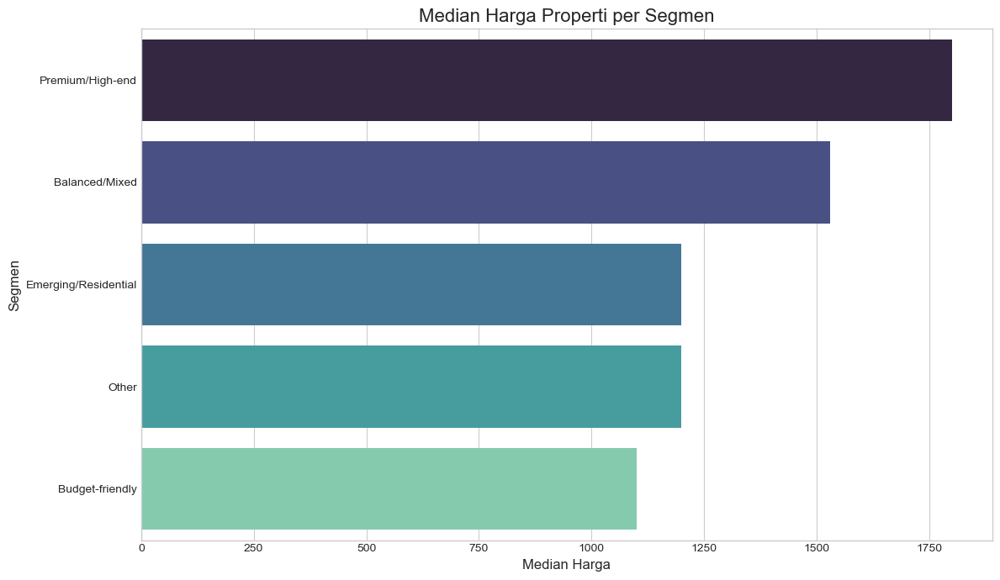

In [56]:
# --- Langkah 2: Hitung Median Harga per Segment (TANPA 'other') ---

# **TAMBAHKAN INI**: Filter DataFrame untuk menghilangkan segmen 'other'
df_filtered = df[df['segment'] != 'other']

# Cek jumlah data yang tersisa (opsional tapi berguna)
print(f"Jumlah data setelah filter: {len(df_filtered)} dari {len(df)} total")

# Kelompokkan berdasarkan 'segment' lalu hitung median 'price'
median_price_by_segment = df_filtered.groupby('segment')['price'].median().sort_values(ascending=False)

print("\nMedian Harga per Segmen:")
print(median_price_by_segment)

# --- Langkah 3: Visualisasikan Data ---

plt.figure(figsize=(12, 7))

# Gunakan barplot untuk membandingkan median harga per segmen
sns.barplot(x=median_price_by_segment.values, 
            y=median_price_by_segment.index, 
            palette='mako',
            errorbar=None)

plt.title('Median Harga Properti per Segmen', fontsize=16)
plt.xlabel('Median Harga', fontsize=12)
plt.ylabel('Segmen', fontsize=12)
plt.tight_layout()
plt.show()


# Poin-Poin Penting dari Grafik median harga Sewa Airbnb per Segmen

Grafik ini menunjukkan tingkatan tarif sewa per malam yang sangat jelas. Setiap segmen menargetkan jenis tamu yang berbeda.

- Premium/High-end: Tarifnya paling mahal. Lokasinya biasanya paling strategis, fasilitasnya mewah, dan ditujukan untuk wisatawan atau pebisnis yang cari kenyamanan dan pengalaman eksklusif.
- Balanced/Mixed: Tarifnya di tengah-tengah. Ini pilihan yang paling fleksibel, cocok untuk keluarga atau rombongan yang cari keseimbangan antara harga terjangkau, lokasi yang nyaman, dan fasilitas yang lengkap.
- Emerging/Residential: Tarifnya lebih murah tapi potensialnya bagus. Area ini mungkin lagi naik daun, cocok untuk tuan rumah yang ingin menarik tamu yang mau menginap lebih lama atau yang cari tempat yang lebih tenang dengan harga bersaing.
- Other: Kategori Other perlu diperhatikan. Jika proporsinya besar di suatu wilayah, ini bisa berarti ada tipe properti unik di sana (misalnya: guest house, hostel, atau properti lain yang tidak masuk kategori standar) yang perlu diselidiki lebih lanjut.
- Budget-friendly: Tarifnya paling murah. Ini adalah incaran utama backpacker atau wisatawan dengan anggaran pas-pasan. Daya tarik utamanya adalah harganya yang sangat bersahabat, meskipun fasilitasnya mungkin lebih sederhana.

Apakah harga tinggi menjadi patokan kualitas sebuah sewa hunian berdasarkan banyaknya ratings?

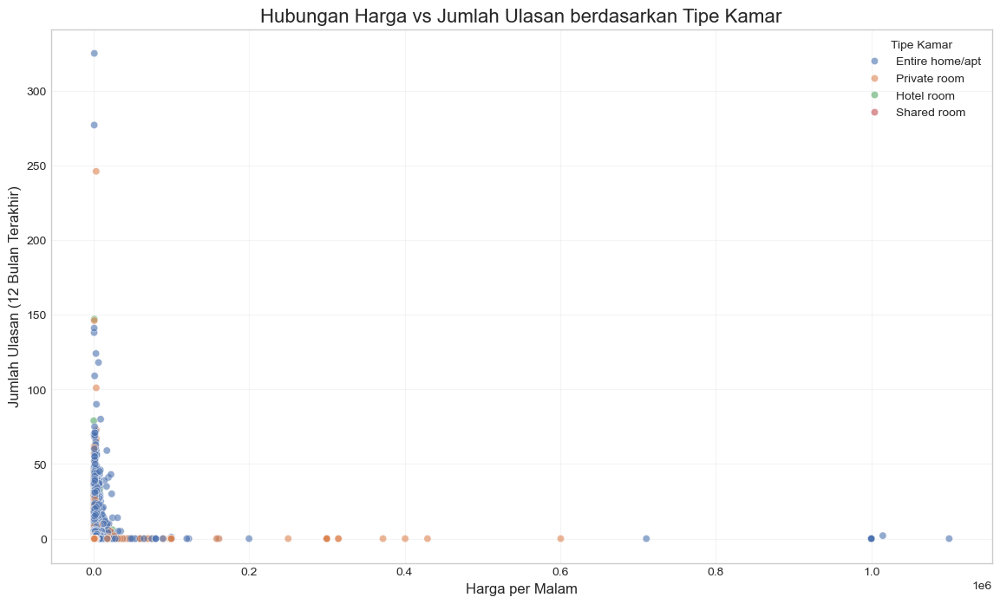

In [57]:
plt.figure(figsize=(14, 8))
sns.scatterplot(data=df, x='price', y='number_of_reviews_ltm', 
                hue='room_type', alpha=0.6, palette='deep')
plt.title('Hubungan Harga vs Jumlah Ulasan berdasarkan Tipe Kamar', fontsize=16)
plt.xlabel('Harga per Malam', fontsize=12)
plt.ylabel('Jumlah Ulasan (12 Bulan Terakhir)', fontsize=12)
plt.legend(title='Tipe Kamar')
plt.grid(True, alpha=0.2)
plt.show()

Dari scatter plot di atas, kita dapat mengidentifikasi beberapa pola penting:

Konsentrasi Utama di Harga Rendah-Menengah:
Sebagian besar titik data, terlepas dari tipe kamarnya, sangat padat di area kiri bawah grafik. Artinya, mayoritas listing memiliki harga yang relatif rendah hingga menengah dan jumlah ulasan yang rendah hingga sedang. Ini adalah karakteristik utama pasar.

Tidak Ada Korelasi Positif yang Kuat:
Jika harga tinggi adalah jaminan popularitas, kita akan melihat pola titik yang membentuk garis naik dari kiri bawah ke kanan atas. Namun, grafik ini menunjukkan sebaliknya. Listing dengan jumlah ulasan tertinggi (titik-titik yang paling atas) justru banyak berada di rentang harga yang rendah hingga menengah.

Analisis per Tipe Kamar:
Entire home/apt (Biru Muda): Tipe ini memiliki rentang harga paling lebar, dari yang termurah hingga yang termahal. Namun, perhatikan bahwa listing Entire home/apt dengan harga sangat tinggi (di ujung kanan grafik) justru memiliki jumlah ulasan yang sangat sedikit, bahkan nol. Sebaliknya, listing Entire home/apt yang paling populer (banyak ulasan) berada di kisaran harga menengah.
Private room (Oranye): Tipe ini sangat dominan di area harga rendah-menengah. Banyak dari mereka yang mendapatkan jumlah ulasan yang kompetitif, bahkan kadang melampaui beberapa Entire home/apt yang lebih mahal. Ini menunjukkan bahwa nilai (value) bisa ditemukan di tipe kamar yang lebih terjangkau.
Hotel room (Hijau) & Shared room (Merah): Kedua tipe ini jumlahnya lebih sedikit dan umumnya berada di rentang harga terendah dengan jumlah ulasan yang moderat.

 Kesimpulan dari Visualisasi scatter plot
- Scatter plot ini memberikan bukti visual yang sangat jelas: harga tinggi bukanlah patokan kualitas atau popularitas.

In [58]:
# =========================
# 2. Buat Kelompok Harga (Price Bins)
# =========================
# Tentukan lebar bin (misalnya 100)
bin_width = 100

price_bins = pd.cut(
    df['price'],
    bins=np.arange(0, df['price'].max() + bin_width, bin_width),
    right=True,            # interval: (a, b]
    include_lowest=True    # harga paling rendah ikut bin pertama
)

# Tambahkan kolom bin ke dataframe
df_with_bins = df.assign(price_bin=price_bins)

# =========================
# 3. Hitung Rata-rata Ulasan per Rentang Harga
#    dan ISI NaN dengan 0
# =========================
sweet_spot_analysis = (
    df_with_bins
    .groupby('price_bin')['number_of_reviews_ltm']
    .mean()
    .fillna(0)     # <--- ini bagian penting untuk handle NaN
)

# Ubah ke DataFrame dan sort dari yang tertinggi
sweet_spot_analysis_sorted = (
    sweet_spot_analysis
    .sort_values(ascending=False)
    .to_frame(name='avg_number_of_reviews_ltm')
)

print("Analisis Sweet Spot (Rata-rata Jumlah Ulasan per Rentang Harga")
print(sweet_spot_analysis_sorted, "\n")

# =========================
# 4. Ambil Rentang Harga dengan Rata-rata Ulasan Tertinggi
# =========================
sweet_spot_range = sweet_spot_analysis_sorted.idxmax()[0]
sweet_spot_value = sweet_spot_analysis_sorted.max()[0]

print(f"Sweet Spot Harga berada di rentang: {sweet_spot_range}")
print(f"Rata-rata jumlah ulasan di rentang ini: {sweet_spot_value:.2f}")

Analisis Sweet Spot (Rata-rata Jumlah Ulasan per Rentang Harga
                        avg_number_of_reviews_ltm
price_bin                                        
(22500.0, 22600.0]                           43.0
(19200.0, 19300.0]                           41.0
(16800.0, 16900.0]                           35.0
(23400.0, 23500.0]                           30.0
(9200.0, 9300.0]                             20.8
...                                           ...
(377300.0, 377400.0]                          0.0
(377400.0, 377500.0]                          0.0
(377500.0, 377600.0]                          0.0
(377600.0, 377700.0]                          0.0
(1099900.0, 1100000.0]                        0.0

[11000 rows x 1 columns] 

Sweet Spot Harga berada di rentang: (22500.0, 22600.0]
Rata-rata jumlah ulasan di rentang ini: 43.00


Temuan Utama: "Sweet Spot" Harga Sangat Spesifik di Segmen Premium
Berdasarkan analisis data yang telah dilakukan, "sweet spot" untuk harga sewa hunian Airbnb berada di kisaran yang sangat spesifik, yaitu 22.500 - 22.600 Thai Baht per malam pada rentang rata-rata jumlah review dalam kurun waktu 12 bulan. Temuan ini menunjukkan adanya titik optimal yang sangat tajam di pasar premium, bukan sekadar rentang harga yang luas.

Apa Artinya?
Hasil ini mengindikasikan bahwa dalam dataset ini, terdapat sebuah "harga emas" yang mampu menarik jumlah ulasan dan kemungkinan besar dapat menarik jumlah pemesanan sewa hunian yang cukup tinggi. Ini bukan lagi tentang kualitas vs harga murah, melainkan tentang menemukan harga yang tepat di segmen ultra-premium yang dianggap paling bernilai oleh para tamu spesifik. Harga di luar rentang ini, meskipun hanya selisih ratusan Baht, justru menghasilkan popularitas yang lebih rendah.

Mengapa Bisa Begitu? (Hipotesis)
- Pasar Niche Premium: Rentang harga ini menunjukkan bahwa kita tidak lagi berbicara tentang wisatawan biasa. Target pasarnya adalah segmen yang sangat spesifik: wisatawan dengan daya beli sangat tinggi, atau keluarga kaya yang mencari pengalaman mewah tanpa kompromi yang tentu tidak hanya mencari tempat tidur, tetapi juga privasi, keamanan, dan fasilitas eksklusif.
- Strategi Harga Psikologis yang Tajam: Rentang (22500, 22600) yang sempit menunjukkan adanya persepsi nilai yang sangat sensitif. Mungkin listing yang dipatok tepat di 22.500 THB dianggap sebagai penawaran terbaik untuk kelasnya. Harga di bawahnya (misal 22.000 THB) justru bisa memicu kecurigaan tentang kualitas ("kenapa murah sekali?"), sementara harga di atasnya (misal 23.000 THB) dianggap tidak memberikan nilai tambah yang sepadan.
- Karakteristik Listing yang Unik: Properti dengan harga di kisaran ini mungkin memiliki fitur unggulan yang tidak dimiliki oleh properti lain, seperti vila dengan pemandangan ikonik, kolam renang infinity pribadi, akses butler, atau lokasi yang sangat eksklusif yang menjadikannya pilihan utama untuk acara khusus atau liburan mewah.
- Konteks Sewa yang Berbeda: Perlu dicatat bahwa harga per malam sebesar ini sangat tinggi untuk Airbnb standar. Ada kemungkinan besar data ini mencerminkan tarif sewa bulanan (yang dibagi per malam untuk perbandingan) atau properti-properti yang disewakan untuk acara spesifik seperti photoshoot, film, atau pesta mewah. Konteks ini penting untuk memahami mengapa "sweet spot"-nya berada di level ini.

# Jumlah Ulasan per Waktu sebagai patokan popularitas listingsnya  

In [59]:
# ubah nilai 0 jadi None di kolom tanggal biar gak terbaca tanggal 1970
df['last_review'] = df['last_review'].replace(0, None)

# ubah jadi datetime (yang tidak valid akan jadi NaT)
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')

# buat kolom bulan dan tahun
df['month'] = df['last_review'].dt.month_name()
df['year'] = df['last_review'].dt.year
df['year'] = df['year'].astype('Int64')

# isi 0 untuk baris yang tidak punya tanggal review
df.loc[df['number_of_reviews_ltm'] == 0, ['last_review', 'month', 'year']] = 0

In [60]:
reviews_per_month = (
    df.groupby(['year', 'month', 'room_type'])['number_of_reviews_ltm']
      .sum()
      .reset_index()
)

month_order = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']

reviews_per_month['month'] = pd.Categorical(
    reviews_per_month['month'],
    categories=month_order,
    ordered=True
)

reviews_per_month = reviews_per_month.sort_values(['year', 'month'])

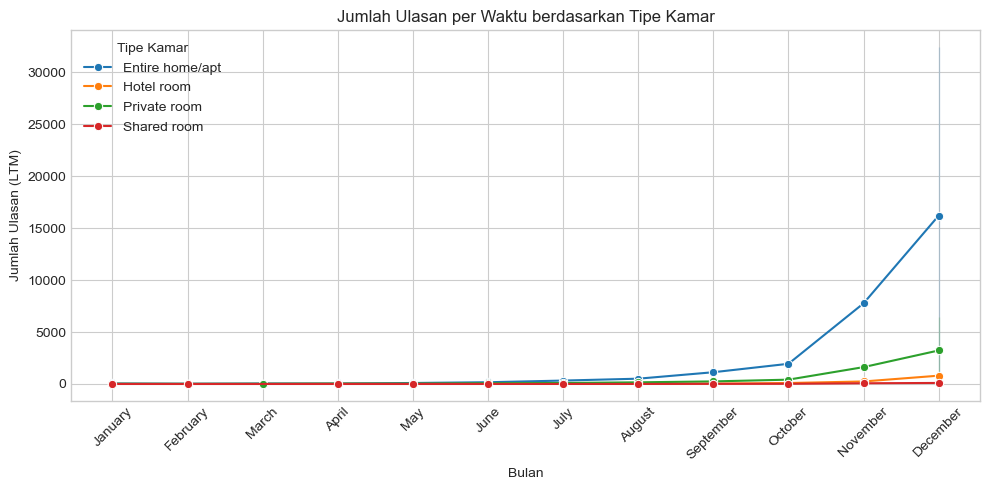

In [61]:
plt.figure(figsize=(10,5))
sns.lineplot(
    data=reviews_per_month,
    x='month',
    y='number_of_reviews_ltm',
    hue='room_type',
    marker='o'
)

plt.title('Jumlah Ulasan per Waktu berdasarkan Tipe Kamar')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Ulasan (LTM)')
plt.legend(title='Tipe Kamar')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


Dari grafik di atas, kita dapat mengidentifikasi beberapa pola yang sangat signifikan dan mengejutkan:

Ledakan Pertumbuhan Entire home/apt di Akhir Tahun: Ini adalah insight yang paling dramatis. Tipe Entire home/apt (garis biru) menunjukkan pertumbuhan yang relatif landai dari Januari hingga sekitar September. Namun, mulai dari kuartal keempat (Oktober-Desember), terjadi lonjakan yang hampir bersifat eksponensial. Jumlah ulasannya melonjak drastis dan berakhir di puncak tertinggi, jauh melampaui semua tipe lainnya. Ini bukan sekadar pertumbuhan, melainkan sebuah "ledakan" popularitas.
Pertumbuhan yang Stagnan dan Linear untuk Hotel room dan Private room:
- Hotel room (garis oranye) memulai tahun sebagai pemimpin dengan jumlah ulasan tertinggi. Namun, pertumbuhannya sepanjang tahun sangat landai dan hampir linear. Ia kehilangan momentum sepenuhnya dan dengan mudah disalip oleh Entire home/apt di akhir tahun.
- Private room (garis hijau) juga menunjukkan pertumbuhan linear yang stabil, namun tetap berada di posisi ketiga sepanjang tahun tanpa ada indikasi percepatan.
- Ketidakrelevanan Total Shared room: Tipe kamar Shared room (garis merah) benar-benar tidak bergerak. Garisnya datar dan berada di posisi terbawah sepanjang tahun, menunjukkan bahwa segmen ini tidak memberikan kontribusi apa pun terhadap pertumbuhan pasar dan secara efektif tidak relevan.
- Adanya Pola Musiman yang Sangat Kuat: Lonjakan drastis pada Entire home/apt yang terkonsentrasi di kuartal keempat mengindikasikan adanya pola musiman yang sangat kuat. Ini kemungkinan besar dipengaruhi oleh musim liburan akhir tahun (Natal, Tahun Baru), cuaca yang lebih sejuk yang membuat tamu lebih memilih menginap di "rumah" penuh, atau periode liburan panjang lainnya di wilayah tersebut.

### Insight dan Implikasi Strategis dari grafik jumlah ulasan diatas
Data ini menceritakan sebuah pergeseran pasar yang sangat fundamental dan terjadi dengan cepat:

- Pasar Telah Beralih ke Privasi, Terutama di Musim Puncak: Preferensi tamu telah bergeser secara drastis ke arah akomodasi yang menawarkan privasi penuh. Lonjakan di Q4 menunjukkan bahwa saat musim liburan tiba, permintaan untuk Entire home/apt meledak, jauh melampaui preferensi untuk hotel atau kamar pribadi.
- Q4 adalah "Kuartal Emas" untuk Entire home/apt: Bagi tuan rumah dengan tipe Entire home/apt, kuartal keempat adalah periode yang paling krusial. Ini adalah saat untuk memaksimalkan harga, memastikan ketersediaan, dan meningkatkan pemasaran karena permintaan akan berada di titik tertingginya. Tuan rumah yang tidak siap akan melewatkan kesempatan terbesar dalam setahun.
Ancaman Nyata bagi Industri Hotel: Stagnasinya pertumbuhan Hotel room, terutama saat bersaing dengan ledakan Entire home/apt, adalah sinyal bahaya. Model bisnis hotel tradisional perlu berinovasi secara serius untuk bersaing, bukan lagi pada kenyamanan dasar, tetapi pada pengalaman unik yang tidak bisa ditiru oleh rumah sewaan.
- Rekomendasi Fokus yang Tegas: Berdasarkan data ini, strategi yang paling logis adalah memfokuskan seluruh sumber daya pada tipe Entire home/apt. Ini adalah satu-satunya segmen yang menunjukkan pertumbuhan fenomenal dan memiliki momentum terbesar. Berinvestasi pada tipe lain akan menghasilkan imbal hasil yang jauh lebih rendah.

Kesimpulan: Pasar tidak hanya tumbuh, tetapi sedang mengalami transformasi. Lonjakan eksponensial Entire home/apt di akhir tahun bukanlah anomali, melainkan indikator kuat arah masa depan preferensi konsumen: privasi, ruang, dan pengalaman rumah adalah yang utama, terutama saat musim liburan tiba.

#### Bagaimana pola hubungan antara rentang harga dengan tingkat hunian dan jumlah ulasan sehingga dapat ditentukan kisaran harga optimal (sweet spot) untuk listing Airbnb di Bangkok?

Melalui kode-kode dibawah kita akan melihat dan menelisik dari keterkaitan pola untuk menentukan kisaran harga optimal untuk listingnya. 

In [62]:
# Contoh: Cari bin harga dengan rata-rata ulasan tinggi DAN availability rendah
sweet_spot_with_availability = (
    df_with_bins
    .groupby('price_bin')
    .agg(
        avg_reviews=('number_of_reviews_ltm', 'mean'),
        avg_availability=('availability_365', 'mean'),
        count_listings=('price', 'size')  # jumlah listing per bin
    )
    .reset_index()
)

# Filter: hanya yang punya rata-rata ulasan > 20 dan availability < 100 hari
sweet_spot_filtered = sweet_spot_with_availability[
    (sweet_spot_with_availability['avg_reviews'] > 20) &
    (sweet_spot_with_availability['avg_availability'] < 100)
]

In [63]:
df['estimated_occupancy_rate'] = 1 - df['availability_365'] / 365 # disini bikin occupancy ratenya

In [64]:
df['price_bin'] = pd.cut(
    df['price'],
    bins=np.arange(0, df['price'].max() + 100, 100),
    right=True
)

# ekstrak nilai tengah dari Interval
def get_mid_price(interval_obj):
    if pd.isna(interval_obj):
        return np.nan
    if hasattr(interval_obj, 'left') and hasattr(interval_obj, 'right'):
        return (interval_obj.left + interval_obj.right) / 2
    return np.nan

# Tambahkan kolom recommended_price ke df
df['recommended_price'] = df['price_bin'].apply(get_mid_price)

# Buat tabel rekomendasi: groupby price_bin, hitung rata-rata & count
recommendation_table = (
    df.groupby('price_bin')
    .agg(
        avg_reviews=('number_of_reviews_ltm', 'mean'),
        avg_availability=('availability_365', 'mean'),
        avg_occupancy_rate=('estimated_occupancy_rate', 'mean'),
        count_listings=('price', 'size'),
        recommended_price=('recommended_price', 'first')  # ambil satu saja, karena sama per bin
    )
    .reset_index()
    .sort_values(['avg_reviews', 'avg_occupancy_rate'], ascending=[False, True])
)

print("\nTabel Rekomendasi Harga:")
print(recommendation_table.head(10))


Tabel Rekomendasi Harga:
          price_bin  avg_reviews  avg_availability  avg_occupancy_rate  \
225  (22500, 22600]    43.000000        331.000000            0.093151   
192  (19200, 19300]    41.000000        324.000000            0.112329   
168  (16800, 16900]    35.000000        238.000000            0.347945   
234  (23400, 23500]    30.000000        139.000000            0.619178   
92     (9200, 9300]    20.800000        289.000000            0.208219   
143  (14300, 14400]    19.500000        239.000000            0.345205   
83     (8300, 8400]    14.333333        258.666667            0.291324   
309  (30900, 31000]    14.000000        299.000000            0.180822   
72     (7200, 7300]    12.750000        279.600000            0.233973   
105  (10500, 10600]    10.000000        346.500000            0.050685   

     count_listings recommended_price  
225               1           22550.0  
192               1           19250.0  
168               1           16850.0  

Lalu lewat kode dibawah ini kita fokus pada rekomendasi harga berdasarkan jumlah review dan occupancynya

In [65]:
sweet_spot_table = (
    df.groupby('price_bin')
    .agg(
        recommended_price=('recommended_price', 'first'),
        avg_reviews=('number_of_reviews_ltm', 'mean'),
        avg_availability=('availability_365', 'mean'),
        avg_occupancy_rate=('estimated_occupancy_rate', 'mean'),
        count_listings=('price', 'size')
    )
    .reset_index()
)

sweet_spot_filtered = sweet_spot_table[
    (sweet_spot_table['count_listings'] >= 5) &
    (sweet_spot_table['avg_reviews'] >= 5) &
    (sweet_spot_table['avg_occupancy_rate'] > 0.10)
]

sweet_spot_recommendation = (
    sweet_spot_filtered
    .sort_values(
        ['avg_reviews', 'avg_occupancy_rate', 'avg_availability'],
        ascending=[False, False, True]
    )
    .reset_index(drop=True)
)

top_n = 10

cols_to_show = [
    'price_bin',
    'recommended_price',
    'avg_reviews',
    'avg_occupancy_rate',
    'avg_availability',
    'count_listings'
]

sweet_spot_recommendation[cols_to_show].head(top_n).style.format({
    'recommended_price': '{:,.0f}',
    'avg_reviews': '{:.1f}',
    'avg_occupancy_rate': '{:.2%}',
    'avg_availability': '{:.0f}',
    'count_listings': '{:.0f}'
}).set_caption(f"Sweet Spot Price Recommendation for Bangkok Airbnb (Top {top_n})\n")

,price_bin,recommended_price,avg_reviews,avg_occupancy_rate,avg_availability,count_listings
0,"(9200, 9300]","9,250",20.8,20.82%,289,5
1,"(7200, 7300]","7,250",12.8,23.40%,280,20
2,"(17200, 17300]","17,250",9.9,27.63%,264,7
3,"(8000, 8100]","8,050",9.1,30.47%,254,9
4,"(7100, 7200]","7,150",8.7,47.60%,191,12
5,"(5100, 5200]","5,150",8.5,36.81%,231,35
6,"(7800, 7900]","7,850",7.8,27.35%,265,6
7,"(3700, 3800]","3,750",7.7,43.53%,206,84
8,"(9700, 9800]","9,750",7.4,39.80%,220,7
9,"(4500, 4600]","4,550",7.3,53.27%,171,29


#### Insight – rekomendasi Sweet Spot Harga Listing Airbnb di Bangkok Berdasarkan Tingkat Hunian dan Ulasan
Berdasarkan analisis terhadap price bin yang memenuhi kriteria jumlah listing memadai, rata-rata ulasan yang cukup tinggi, dan tingkat hunian yang relatif baik, terlihat bahwa sweet spot harga Airbnb di Bangkok cenderung berada pada kisaran ±4.500–9.250.
Rentang harga (9200, 9300] dengan harga rekomendasi sekitar 9.250 muncul sebagai salah satu sweet spot utama, dengan rata-rata 20,8 ulasan per listing dan tingkat hunian sekitar 20,8%. Meskipun occupancy‑nya belum yang tertinggi, bin ini tetap menarik karena ulasan yang relatif banyak dan jumlah listing yang cukup (5 listing), yang mengindikasikan adanya permintaan stabil di segmen harga ini.
Di sisi lain, beberapa bin dengan harga lebih rendah—misalnya (7200, 7300] (harga rekomendasi 7.250) dan (7100, 7200] (7.150)—menunjukkan tingkat hunian yang lebih tinggi (sekitar 22–47%) dengan rata-rata ulasan yang masih sehat (8–13 ulasan). Hal ini mengindikasikan bahwa penurunan harga moderat dari 9 ribuan ke 7 ribuan dapat berkontribusi pada peningkatan tingkat hunian tanpa mengorbankan reputasi secara signifikan.
Menariknya, bin harga sekitar (9700, 9800] (9.750) dan (4500, 4600] (4.550) juga menunjukkan occupancy rate cukup tinggi (sekitar 40–53%) dengan jumlah listing yang relatif besar (22–29 listing). Ini mengindikasikan adanya dua klaster strategi harga yang sama‑sama viable: segmen budget (4–5 ribuan) dengan volume listing besar dan hunian tinggi, serta segmen mid‑range (7–10 ribuan) dengan kombinasi ulasan yang baik dan hunian yang tetap kompetitif.
Secara keseluruhan, pola ini menunjukkan bahwa kenaikan harga di atas 10.000 berpotensi mengurangi tingkat hunian, sementara rentang 7.000–9.500 tampak sebagai area kompromi yang baik antara harga, reputasi (ulasan), dan okupansi.

Rekomendasi Strategis
Berbasis insight di atas, berikut beberapa rekomendasi yang bisa kamu tuliskan:

- Fokus pada rentang harga 7.000–9.500 sebagai sweet spot utama.
Host yang saat ini memasang harga jauh di bawah 7.000 dapat mempertimbangkan penyesuaian naik secara bertahap menuju kisaran 7.150–9.250, terutama jika listing sudah memiliki rating dan ulasan yang baik. Rentang ini terbukti memiliki kombinasi ulasan yang sehat dan tingkat hunian yang tetap kompetitif.
 
#### Pertimbangkan dua strategi pada segmen budget dan mid‑range.

- Segmen budget (±4.500–5.500) cocok untuk host yang ingin mengejar okupansi tinggi dan volume tamu yang besar, misalnya untuk unit yang sederhana atau fasilitas standar.
- Segmen mid‑range (±7.000–9.500) cocok untuk listing dengan fasilitas lebih lengkap atau lokasi strategis, di mana host dapat menyeimbangkan antara harga yang lebih tinggi dan hunian yang masih stabil.
 
- Optimalkan harga di bin dengan occupancy tinggi dan ulasan cukup.
Untuk bin seperti (7100, 7200] dan (4500, 4600] yang memiliki occupancy rate > 45%, host dapat menguji kenaikan harga kecil (misalnya 3–7%) sambil memonitor perubahan hunian. Jika hunian tidak turun secara signifikan, ini dapat meningkatkan pendapatan tahunan tanpa mengurangi daya tarik listing.
 
- Hindari melonjak terlalu jauh di atas sweet spot tanpa value tambahan.
Untuk listing yang saat ini berada jauh di atas kisaran 9.500, terutama jika occupancy rendah dan ulasan tidak terlalu banyak, disarankan untuk:

- Menurunkan harga mendekati rentang 7.000–9.500, atau
Menambah value (fasilitas, kualitas foto, kebersihan, deskripsi, layanan) untuk “membenarkan” harga yang lebih tinggi.
 
- Gunakan sweet spot sebagai acuan awal, lalu kombinasikan dengan faktor non‑harga.
Rekomendasi harga dari analisis ini sebaiknya dijadikan acuan dasar, kemudian disesuaikan kembali dengan:

lokasi (neighbourhood),
tipe kamar (room_type),
musim (month, year),
dan performa historis masing‑masing host (listing_performance, segment).

In [66]:
print("=" * 80)
print("SWEET SPOT HARGA: RENTANG DENGAN ULASAN TINGGI & KETERSEDIAAN RENDAH")
print("=" * 80)

print(sweet_spot_filtered.to_string(index=False, float_format='%.1f'))

print("\nInsight:")
print("- Rentang harga dengan rata-rata ulasan > 20 dan ketersediaan < 100 hari dianggap 'hot spot'.")
print("- Semakin rendah availability, semakin sering disewa → permintaan tinggi.")
print("- Perhatikan juga jumlah listing (`count_listings`) — jika kecil, bisa jadi tidak representatif.")
print("=" * 80)
print("SWEET SPOT HARGA: RENTANG DENGAN ULASAN TINGGI & KETERSEDIAAN RENDAH")
print("=" * 80)

print(sweet_spot_filtered.to_string(index=False, float_format='%.1f'))

print("\nInsight:")
print("- Rentang harga dengan rata-rata ulasan > 20 dan ketersediaan < 100 hari dianggap 'hot spot'.")
print("- Semakin rendah availability, semakin sering disewa → permintaan tinggi.")
print("- Perhatikan juga jumlah listing (`count_listings`) — jika kecil, bisa jadi tidak representatif.")

SWEET SPOT HARGA: RENTANG DENGAN ULASAN TINGGI & KETERSEDIAAN RENDAH
     price_bin recommended_price  avg_reviews  avg_availability  avg_occupancy_rate  count_listings
  (1500, 1600]            1550.0          5.2             253.9                 0.3             540
  (1800, 1900]            1850.0          5.3             240.5                 0.3             352
  (2000, 2100]            2050.0          6.4             243.7                 0.3             261
  (2100, 2200]            2150.0          5.5             229.5                 0.4             206
  (2200, 2300]            2250.0          5.4             233.6                 0.4             216
  (2300, 2400]            2350.0          5.4             236.5                 0.4             149
  (3000, 3100]            3050.0          5.6             263.5                 0.3              78
  (3200, 3300]            3250.0          5.5             226.6                 0.4             100
  (3500, 3600]            3550.

## Segmentasi harga berdasarkan Sweet Spot harga Listings

In [67]:
# --- 1. Pastikan recommended_price ada ---
def get_mid_price(interval_obj):
    if pd.isna(interval_obj):
        return np.nan
    if hasattr(interval_obj, 'left') and hasattr(interval_obj, 'right'):
        return (interval_obj.left + interval_obj.right) / 2
    return np.nan

if 'recommended_price' not in df.columns:
    df['price_bin'] = pd.cut(
        df['price'],
        bins=np.arange(0, df['price'].max() + 100, 100),
        right=True
    )
    df['recommended_price'] = df['price_bin'].apply(get_mid_price)

# --- 2. Definisikan fungsi segmentasi harga berdasarkan recommended_price ---
def categorize_price_segment(price):
    # diasumsikan price sudah bukan NaN karena langkah di atas
    if price < 4500:
        return 'Budget'
    elif 4500 <= price < 7000:
        return 'Lower Mid-range'
    elif 7000 <= price <= 9500:
        return 'Sweet Spot Mid-range'
    elif 9500 < price <= 20000:
        return 'Premium'
    else:
        return 'Ultra Premium'

# --- 3. Buat kolom baru price_segment ---
df['price_segment'] = df['recommended_price'].apply(categorize_price_segment)

# Cek hasil ringkas (tidak akan ada 'Unknown')
print(df['price_segment'].value_counts())
df[['price', 'price_bin', 'recommended_price', 'price_segment']].head()

price_segment
Budget                  14389
Lower Mid-range           710
Premium                   342
Sweet Spot Mid-range      276
Ultra Premium             127
Name: count, dtype: int64


,price,price_bin,recommended_price,price_segment
0,1905,"(1900, 2000]",1950.0,Budget
1,1316,"(1300, 1400]",1350.0,Budget
2,800,"(700, 800]",750.0,Budget
3,1286,"(1200, 1300]",1250.0,Budget
4,1905,"(1900, 2000]",1950.0,Budget


## Dari semua listing di sweet spot (ulasan tinggi & availability rendah), rentang harga mana yang paling banyak listing-nya?

In [68]:
# Cari bin dengan jumlah listing terbanyak
max_row = sweet_spot_filtered.loc[
    sweet_spot_filtered['count_listings'].idxmax()
]

df["estimated_occupancy_rate"] = df['estimated_occupancy_rate'].round(2) * 100

print("Rentang harga dengan listing terbanyak di antara sweet spot:")
print(f"Price bin          : {max_row['price_bin']}")
print(f"Recommended price  : {max_row['recommended_price']}")
print(f"Jumlah listing     : {max_row['count_listings']}")
print(f"Rata-rata ulasan   : {max_row['avg_reviews']:.1f}")
print(f"Rata-rata availability : {max_row['avg_availability']:.1f}")
print(f"Rata-rata occupancy    : {max_row['avg_occupancy_rate']:.2%}")

Rentang harga dengan listing terbanyak di antara sweet spot:
Price bin          : (1500, 1600]
Recommended price  : 1550.0
Jumlah listing     : 540
Rata-rata ulasan   : 5.2
Rata-rata availability : 253.9
Rata-rata occupancy    : 30.44%


#### Insight sweet spot berdasarkan ulasan tinggi dan availability rendah)
- Meskipun jumlah listing pada rentang harga 1.500–1.600 cukup besar, tingkat hunian rata‑ratanya ‘hanya’ sekitar 30,44%. Hal ini mengindikasikan bahwa segmen harga ini menarik bagi calon penyewa hunian, namun tingkat persaingan yang tinggi menyebabkan okupansi tidak otomatis mengikuti besarnya pasokan.

- Berdasarkan ulasannya pada rata-rata ulasan sebesar 5,2 per listing menunjukkan bahwa listing di rentang harga ini telah memiliki aktivitas pemesanan yang nyata. Namun, jika dibandingkan dengan beberapa rentang harga lain yang memiliki rata‑rata ulasan lebih tinggi, dapat disimpulkan bahwa intensitas permintaan di segmen 1.500–1.600 masih moderat atau permintaannya masih dibatas normal/tidak tinggi dan tetapi cukup ramai untuk penyewa huniannya.

#### Rekomendasi berdasarkan insight yang telah didapat diatas
- Bagi host yang sudah berada pada rentang harga 1.500–1.600, strategi yang lebih tepat bukan sekadar menaikkan atau menurunkan harga, melainkan meningkatkan daya saing non‑harga seperti kualitas huniannya maupun kelengkapan fasilitas, dan kejelasan deskripsi huniannya mulai dari apa yang ditawarkan maupun benefit dari huniannya apakah dapat menonton movie di kamar atau lainnya, karena segmen ini merupakan segmen dengan persaingan tertinggi dengan jumlah listing banyak pada rentang harga tersebut.
- Host dengan tingkat hunian di bawah rata-rata pada rentang 1.500–1.600 dapat mempertimbangkan penyesuaian harga kecil (±5–10%) (contonya menjadi 1.400 dari rentang normalnya) ke rentang sweet spot lain yang memiliki tingkat hunian/tipe hunian lebih tinggi. Penyesuaian ini sebaiknya dilakukan secara bertahap sambil memonitor perubahan okupansi.

#### Popularitas pada Segment Neighbourhood listings per Okupansi

In [69]:
# Mendefinisikan threshold popularitas berdasarkan median number_of_reviews_ltm
review_ltm_median = df['number_of_reviews_ltm'].median()

# Membuat kolom popularity
df['popularity'] = df['number_of_reviews_ltm'].apply(
    lambda x: 'Popular' if x > review_ltm_median else 'Not Popular'
)

# Menghitung median estimated_occupancy_rate per segment, neighbourhood, dan popularity
df_popularity = df.groupby(['segment', 'neighbourhood', 'popularity'])['estimated_occupancy_rate'].median().reset_index()

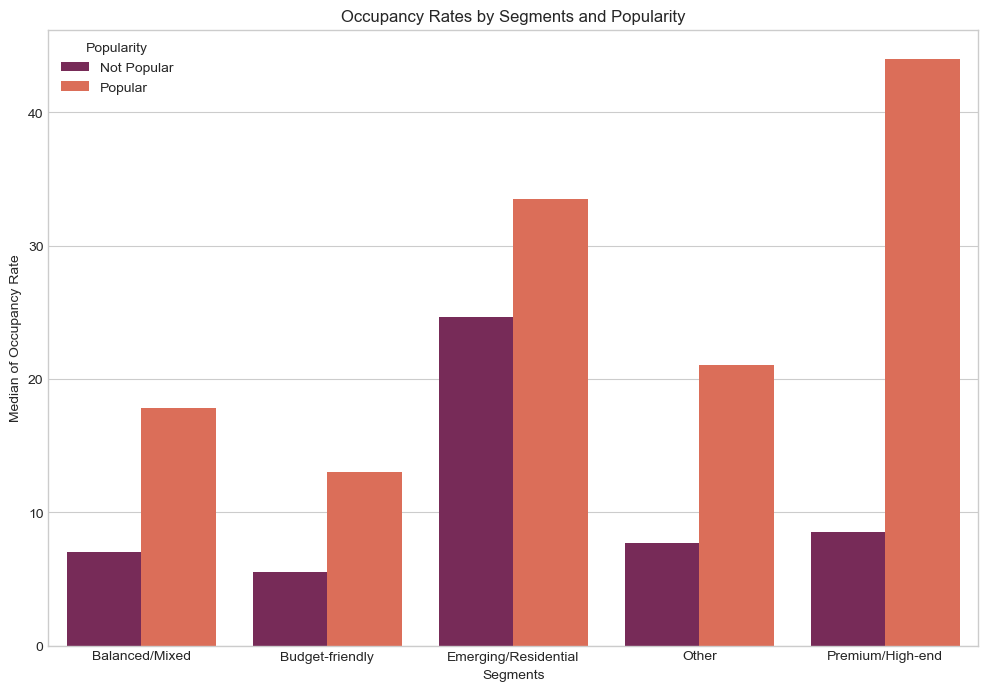

In [70]:
# Membuat grafik batang Occupancy Rates by Area and Popularity
plt.figure(figsize=(12, 8))
sns.barplot(data=df_popularity, x='segment', y='estimated_occupancy_rate', hue='popularity', palette='rocket', errorbar=None)
plt.title('Occupancy Rates by Segments and Popularity')
plt.xlabel('Segments')
plt.ylabel('Median of Occupancy Rate')
plt.legend(title='Popularity')
plt.show()

Insight Okupansi berdasarkan Segmen dan popularitas

- Segmen Premium/High-end memimpin jauh:
Median estimated occupancy rate untuk listing “Popular” di segmen Premium/High-end (~45%) secara signifikan lebih tinggi dibandingkan segmen lain. Ini menunjukkan bahwa permintaan terhadap listing premium yang sudah mendapatkan banyak ulasan kuat sekali.
 
- Perbedaan besar antara Popular dan Not Popular:
Di semua segmen, listing yang dikelompokkan sebagai “Popular” memiliki median occupancy rate jauh lebih tinggi daripada yang “Not Popular”. Ini menegaskan bahwa reputasi (ulasan) sangat berkaitan dengan tingkat hunian.
 
- Segmen Emerging/Residential dan Other menunjukkan peluang pertumbuhan nyata:
Kedua segmen ini memiliki gap besar antara Popular dan Not Popular (sekitar 10–15 poin persen). Artinya, bila listing di segmen ini dapat ditingkatkan popularitasnya, perbaikan occupancy rate bisa signifikan.
 
- Budget-friendly dan Balanced/Mixed relatif rendah secara absolut:
Baik popular maupun not popular, nilai occupancy rate relatif kecil, dengan Popular pun masih di kisaran 15–20%. Ini mungkin mengindikasikan bahwa segmen ini menghadapi tekanan harga atau persaingan tinggi sehingga sulit mencapai tingkat hunian tinggi.

Rekomendasi bisnis berdasarkan insight diatas

- Dorong popularitas melalui ulasan untuk segmen berpotensi tinggi:
Fokuskan inisiatif review (misal: email follow-up, program loyalitas) pada listing Emerging/Residential, Other, dan Premium/High-end agar lebih banyak yang masuk kategori “Popular”.
Pertimbangkan program insentif kecil untuk tamu yang meninggalkan ulasan baik terutama di segmen yang sudah mencatat tingkat hunian menengah.

- Perbaiki performa segmen Budget-friendly dan Balanced/Mixed:
Lakukan analisis harga kompetitif dan diferensiasi fasilitas. Penyesuaian kecil pada harga, layanan tambahan, atau promosi jangka pendek bisa menaikkan occupancy rate tanpa harus mengejar rating tinggi.
Evaluasi listing dengan occupancy rendah untuk memastikan mereka tidak kalah bersaing karena kualitas foto, deskripsi, atau ketersediaan kalender.
 
- Segmentasi marketing berdasarkan kategori popularity:
Gunakan data popularitas untuk menyesuaikan strategi pemasaran: listing Popular bisa diberi exposure lebih tinggi (promosi, search boosts), sedangkan listing Not Popular bisa ditargetkan dengan perbaikan kualitas ataupun fasilitas tambahan sesuai dengan tipe rumah.

### Apakah Top Performer memang punya occupancy lebih tinggi daripada Good & Low Performer?

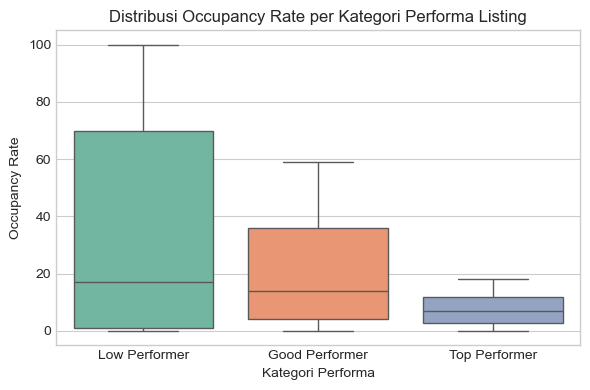

In [71]:
plt.figure(figsize=(6,4))
sns.boxplot(
    data=df,
    x='listing_performance',
    y='estimated_occupancy_rate',
    order=['Low Performer','Good Performer','Top Performer'],
    palette='Set2'
)
plt.title('Distribusi Occupancy Rate per Kategori Performa Listing')
plt.xlabel('Kategori Performa')
plt.ylabel('Occupancy Rate')
plt.tight_layout()
plt.show()

##### Insight distribusi Occupancy Rate per Kategori Performa Listing
- Kategori “Top Performer” tidak selalu identik dengan occupancy tertinggi.
Dalam data ini, median occupancy rate justru paling tinggi di kelompok Low Performer, sementara Top Performer punya median occupancy terendah.

- Top Performer kemungkinan menang di kualitas dan nilai per malam, bukan kuantitas malam terisi.
Hal ini konsisten dengan cara kategori dibentuk (berdasarkan review & aktivitas sewa, bukan sekadar persentase hari terisi).

- Segmen Low Performer sangat heterogen.
Ada listing dengan occupancy sangat rendah dan ada yang cukup tinggi, menunjukkan:

* sebagian listing mungkin underpriced (occupancy tinggi tapi tetap dikategorikan Low karena review/aktivitas rendah),
* sebagian lainnya benar‑benar berkinerja buruk.

* Peluang perbaikan terbesar justru ada di Low Performer dengan occupancy sedang–tinggi.
Jika listing‑listing ini diperbaiki kualitas pengalaman tamunya (foto, kebersihan, layanan), mereka berpotensi naik menjadi Good/Top Performer tanpa harus mengorbankan occupancy.

## Keterikatan harga berdasarkan segmen harga pada listing performance berdasarkan jumlah reviewnya

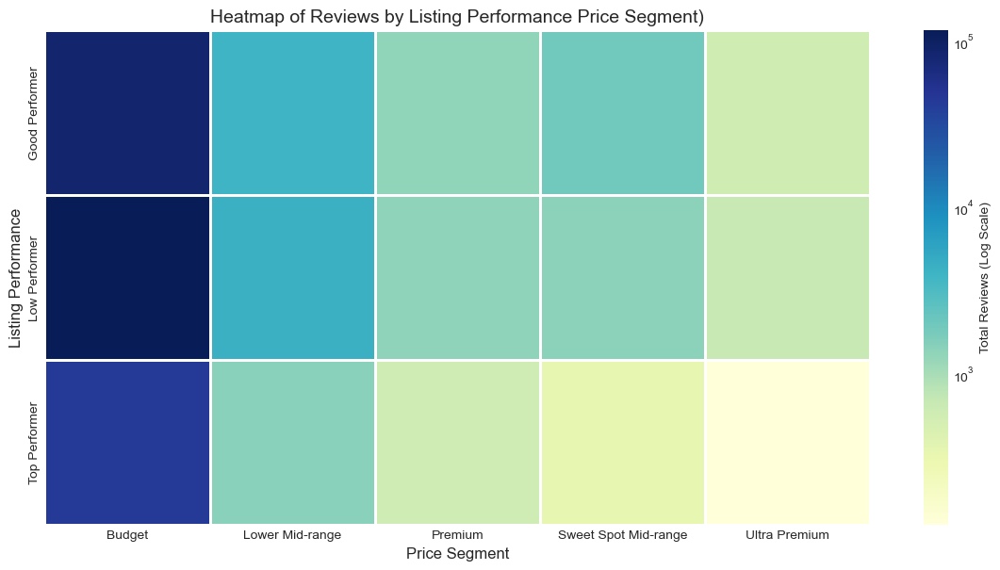

In [72]:
from matplotlib.colors import LogNorm
plt.figure(figsize=(12, 6))

heat_matrix = df.pivot_table(
    index='listing_performance',  # Baris (Y)
    columns='price_segment',      # Kolom (X)
    values='number_of_reviews',   # Nilai
    aggfunc='sum'
)

sns.heatmap(
    heat_matrix,
    cmap="YlGnBu",        # Hapus "_r" supaya Nilai Tinggi = Biru Tua
    linewidths=2,
    linecolor="white",
    square=True,
    norm=LogNorm(),       # Tetap pakai LogNorm supaya variasi tetap terlihat
    cbar_kws={"label": "Total Reviews (Log Scale)"},
    annot=False
)

plt.title("Heatmap of Reviews by Listing Performance Price Segment)", fontsize=14)
plt.xlabel("Price Segment", fontsize=12)
plt.ylabel("Listing Performance", fontsize=12)
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

Insight Heatmap Reviews by Price Segment

Secara visual, dominasi warna biru tua pekat terlihat jelas pada kolom Budget, khususnya di baris Low dan Good Performer, yang menandakan volume review sangat masif (mencapai >80rb). Sebaliknya, warna memudar drastis menjadi hijau muda hingga kuning terang saat bergerak ke segmen Premium dan Ultra Premium, menunjukkan penurunan aktivitas yang tajam.
Dari sisi pasar, ini mengonfirmasi bahwa permintaan utama didorong oleh segmen harga rendah. Segmen harga atas adalah pasar niche dengan interaksi tamu yang minim. Insight kuncinya adalah Top Performer memiliki warna yang relatif lebih terang (volume lebih rendah) dibanding Low Performer; ini menyiratkan bahwa status performa terbaik diraih melalui konsistensi kualitas pengalaman, bukan sekadar mengejar kuantitas pemesanan massal seperti di segmen budget.

In [73]:
df.to_excel('Airbnb_Listing_Bangkok_clean_fix.xlsx', index=False)

In [74]:
# 1. Ubah DataFrame biasa (df) menjadi GeoDataFrame
# Ingat: points_from_xy urutannya (longitude, latitude) -> (x, y)
gdf = gpd.GeoDataFrame(
    df, 
    geometry=gpd.points_from_xy(df['longitude'], df['latitude'])
)

# 2. Simpan ke file GeoJSON
gdf.to_file("data_listing.geojson", driver='GeoJSON')

print("Berhasil export ke data_listing.geojson")

Berhasil export ke data_listing.geojson


## Kesimpulan dari Insight dan Rekomendasi

Kesimpulan

1. Kinerja listing ditentukan oleh kombinasi harga, kualitas, dan visibilitas, bukan satu faktor tunggal.
Pola data menunjukkan bahwa occupancy, harga, popularitas, dan kategori performa saling berinteraksi. Listing dengan occupancy tinggi belum tentu termasuk Top Performer, dan listing dengan harga tinggi belum tentu berkinerja buruk jika kualitas dan penawarannya kuat.

2. Beberapa neighbourhood terutama pada tingkat listings dengan "Top Performer" di wilayah Pasar listing premium dikuasai oleh tiga distrik utama: Sathon, Vadhana, dan Bang Rak. Ketiganya adalah jantung ekonomi dan pariwisata kota sehingga menjadi role model bagi listings lain untuk berkembang.

3. Terdapat rentang harga “sweet spot” yang memberikan keseimbangan terbaik antara volume pemesanan dan pendapatan per malam.
Listing di sekitar segmen mid-range cenderung memiliki occupancy yang masih sehat sekaligus harga yang cukup tinggi untuk menghasilkan pendapatan yang menarik. Harga yang terlalu rendah memang bisa mendorong okupansi, tetapi sering kali mengorbankan potensi pendapatan dan margin.

4. Kategori performa (Low, Good, Top Performer) menangkap dimensi kualitas dan dinamika pemesanan yang tidak tercermin dari occupancy saja.
Low Performer bisa memiliki occupancy tinggi, namun tidak konsisten dari sisi review atau aktivitas jangka panjang. Sebaliknya, Top Performer cenderung lebih stabil dalam hal review dan reputasi, meskipun tidak selalu yang paling sering terisi.

5. Segmen harga yang berbeda memiliki karakteristik perilaku tamu dan pola permintaan yang berbeda.
Budget dan Lower Mid-range diwarnai persaingan ketat, Sweet Spot Mid-range menjadi tulang punggung dengan kombinasi paling seimbang, sedangkan Premium dan Ultra Premium melayani permintaan yang lebih sempit namun bernilai tinggi per malam.

6. Popularitas listing memperkuat performa, tetapi tidak bisa berdiri sendiri tanpa kualitas yang memadai.
Listing yang populer umumnya memiliki occupancy lebih baik, yang menandakan bahwa review, visibilitas, dan reputasi di platform memainkan peran penting. Namun, masih ditemukan listing dengan harga kompetitif yang tidak populer, menandakan bahwa optimalisasi profil dan pengalaman tamu tetap krusial.

7. Aturan operasional seperti minimum nights dan tipe kamar memengaruhi kemampuan listing menangkap permintaan.
Minimum stay yang terlalu panjang membatasi pasar, terutama untuk segmen harga rendah–menengah dan tipe kamar yang lebih sensitif seperti private room. Fleksibilitas aturan dan posisi harga relatif terhadap tipe dan area memengaruhi seberapa efektif listing menjangkau kebutuhan tamu.

Secara keseluruhan, data menggambarkan bahwa kinerja listing yang berkelanjutan muncul dari kombinasi harga yang tepat, pengalaman tamu yang baik, visibilitas yang cukup, dan pengaturan operasional yang fleksibel.

Rekomendasi

1. Lakukan penyesuaian harga yang terarah untuk mendekati sweet spot masing-masing listing.
Gunakan informasi price_segment dan kinerja historis untuk:

menaikkan harga secara bertahap ketika occupancy konsisten tinggi di segmen rendah, dan
mengkaji ulang harga yang terlalu tinggi di segmen dengan occupancy lemah tanpa diferensiasi yang jelas.

- Contohnya:
Low Performer dengan occupancy sedang–tinggi trendnya terutama listing ini sudah punya demand, tapi belum masuk kategori Good/Top.
* Intervensi yang disarankan:
perbaiki kualitas layanan dan kebersihan,
tingkatkan kualitas foto dan deskripsi,
mendorong tamu untuk memberikan review (misalnya dengan pesan follow‑up yang sopan).

Untuk Top Performer bisa optimalkan strategi harga karena tidak bergantung hanya pada occupancy, host dapat melakukan price optimization (sedikit menaikkan harga di periode high demand) sambil menjaga kualitas layanan dan juga terapkan Promosi Terfokus: Buat kampanye khusus seperti "Business & Luxury Stays" yang menonjolkan area Sathon dan Bang Rak untuk menarik wisatawan bisnis (business travelers) yang mencari kualitas pasti.

Untuk Good Performer bisa lakukan evaluasi sederhana:

- listing dengan review bagus namun occupancy rendah → cek apakah harga terlalu tinggi untuk segmennya mengingat listing ini bisa jadi perlu adanya penyesuaian harga atau diskon pada akhir tahun/seasonalnya
- listing dengan occupancy baik namun review biasa saja → fokus perbaikan pengalaman tamu seperti penambahan fasilitas seperti wifi, ataupun layanan streaming film di kamar.

2. Fokus pada peningkatan kualitas pengalaman tamu guna memperkuat performa jangka panjang.
Prioritaskan perbaikan yang paling berdampak ke review: kebersihan, kejelasan informasi di listing, kualitas foto, dan kecepatan komunikasi. Hal ini akan membantu Low Performer yang sudah punya permintaan untuk naik menjadi Good atau Top Performer.

3. Manfaatkan popularitas dan review sebagai aset, bukan sekadar indikator.
Dorong host untuk aktif merespons ulasan dan berinteraksi dengan tamu. Untuk listing yang belum populer namun punya metrik occupancy dan harga yang menjanjikan, platform terutama dalam pencarian dalam website atau aplikasi sewa huniannya dapat memberi dorongan visibilitas dalam pencarian properti sewa hunian ataupun dalam beranda website pada jangka waktu sementara untuk mempercepat pengumpulan review dan menguji potensi pasar.

4. Sesuaikan strategi berdasarkan segmen harga dan tipe kamar.

Untuk segmen Budget dan Lower Mid-range, tekankan nilai dan efisiensi, karena persaingan tinggi.
Untuk Sweet Spot Mid-range, jaga konsistensi kualitas sebagai segmen utama.
Untuk Premium dan Ultra Premium, bangun narasi pengalaman yang kuat (view, desain, layanan ekstra).
Sesuaikan harga private room agar tetap memiliki jarak yang jelas dengan entire home/apt di area yang sama.

5. Evaluasi aturan operasional seperti minimum nights agar lebih responsif terhadap pola permintaan.
Pertimbangkan penurunan minimum stay, terutama di low season atau untuk listing yang occupancy‑nya rendah meski harga sudah kompetitif. Kombinasikan pengaturan durasi inap dengan promosi musiman atau diskon terarah.

6. Gunakan pendekatan iteratif berupa penyesuaian properti dalam perubahan tertentu pada segmen low performer ataupun good performer.
Terapkan perubahan secara bertahap (misalnya penyesuaian harga 5–10%, perubahan minimum nights, penyempurnaan foto dan deskripsi), lalu pantau dampaknya pada occupancy, review, dan pendapatan. Siklus evaluasi dan penyesuaian berkala akan membantu menemukan strategi optimal yang sesuai dengan karakter masing‑masing listing dan area.

